# imports

In [1]:
import pandas as pd
import plotly.graph_objects as go
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression

# data

In [2]:
DAY = 0

In [3]:
df = pd.read_csv(f"./round-3-island-data-bottle/prices_round_3_day_{DAY}.csv", sep=";", header=0)

# trade volumes

## market volumes

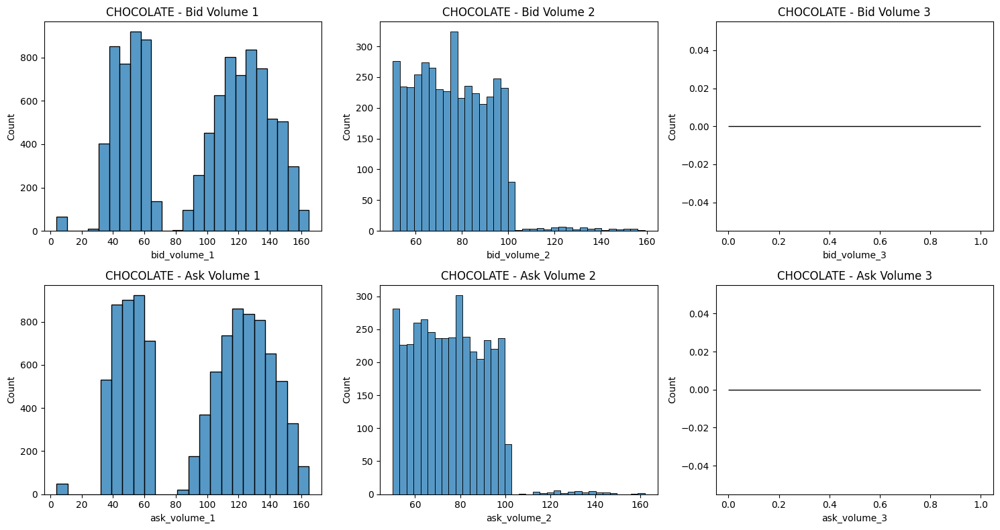

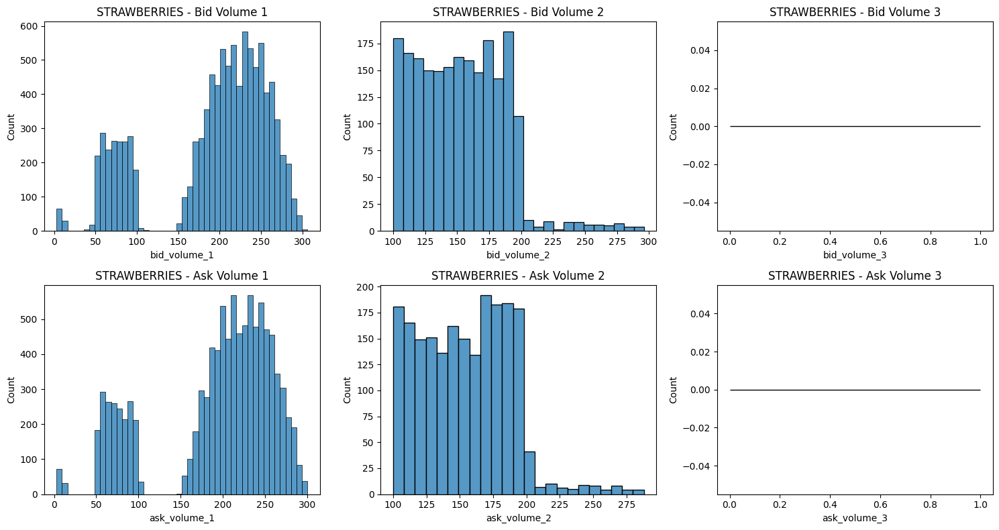

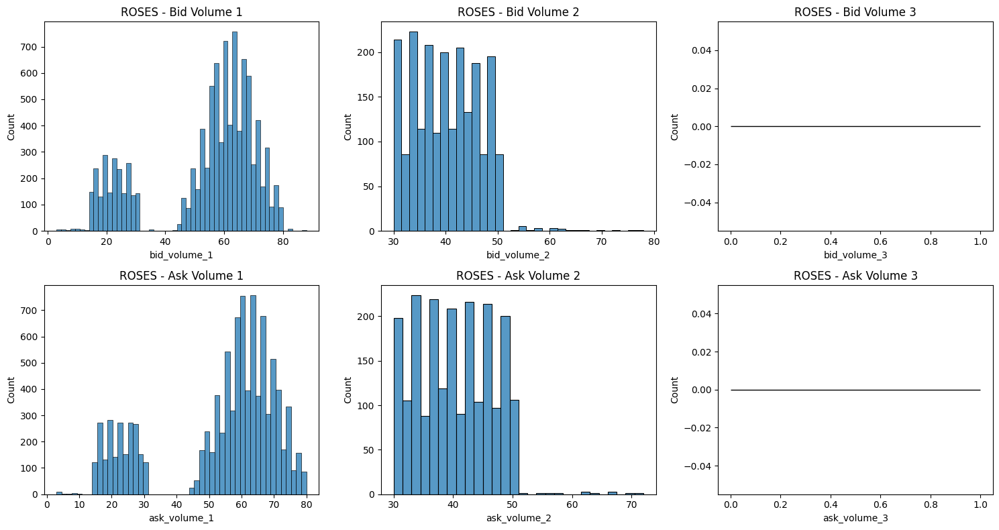

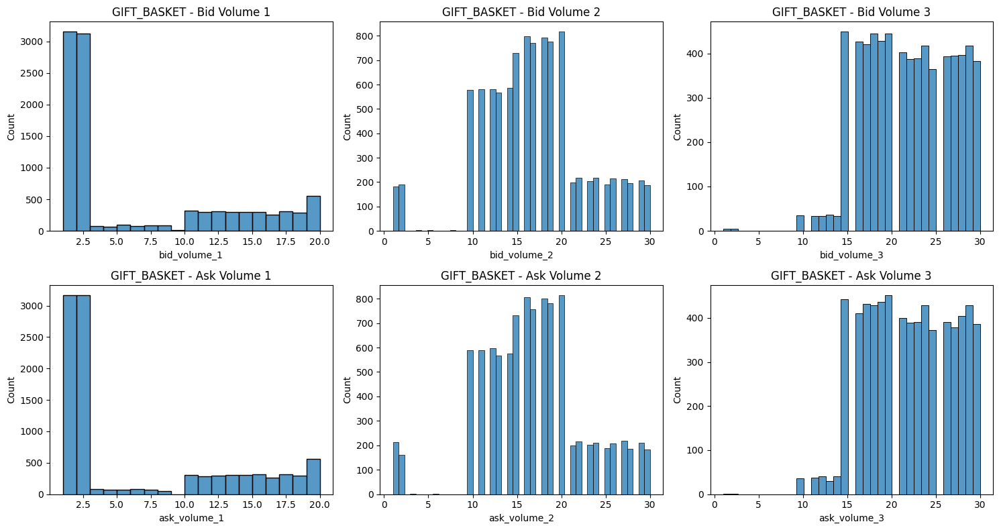

In [4]:
# Get the unique products
unique_products = df['product'].unique()

for product in unique_products:
    # Filter the dataframe for the current product
    product_df = df[df['product'] == product]
    
    # Create a figure with 2 rows and 3 columns
    fig, axes = plt.subplots(2, 3, figsize=(15, 8))
    
    # Plot bid volume histograms
    sns.histplot(data=product_df, x='bid_volume_1', ax=axes[0, 0])
    sns.histplot(data=product_df, x='bid_volume_2', ax=axes[0, 1])
    sns.histplot(data=product_df, x='bid_volume_3', ax=axes[0, 2])
    
    # Plot ask volume histograms
    sns.histplot(data=product_df, x='ask_volume_1', ax=axes[1, 0])
    sns.histplot(data=product_df, x='ask_volume_2', ax=axes[1, 1])
    sns.histplot(data=product_df, x='ask_volume_3', ax=axes[1, 2])
    
    # Set titles for subplots
    axes[0, 0].set_title(f"{product} - Bid Volume 1")
    axes[0, 1].set_title(f"{product} - Bid Volume 2")
    axes[0, 2].set_title(f"{product} - Bid Volume 3")
    axes[1, 0].set_title(f"{product} - Ask Volume 1")
    axes[1, 1].set_title(f"{product} - Ask Volume 2")
    axes[1, 2].set_title(f"{product} - Ask Volume 3")
    
    # Adjust spacing between subplots
    plt.tight_layout()
    
    # Show the plot
    plt.show()

In [5]:
## trade v

# fairs

In [6]:
df.columns

Index(['day', 'timestamp', 'product', 'bid_price_1', 'bid_volume_1',
       'bid_price_2', 'bid_volume_2', 'bid_price_3', 'bid_volume_3',
       'ask_price_1', 'ask_volume_1', 'ask_price_2', 'ask_volume_2',
       'ask_price_3', 'ask_volume_3', 'mid_price', 'profit_and_loss'],
      dtype='object')

## mid price plot for general shape

In [7]:
unique_products = df['product'].unique()

fig = go.Figure()

for i, product in enumerate(unique_products):
    product_df = df[df['product'] == product]
    
    fig.add_trace(go.Scatter(
        x=product_df['timestamp'],
        y=product_df['mid_price'],
        mode='lines',
        name=product,
        yaxis=f'y{i+1}'
    ))
    
    fig.update_layout(**{f'yaxis{i+1}': {'title': f'Mid Price ({product})', 'overlaying': 'y' if i > 0 else None, 'side': 'right' if i % 2 else 'left'}})

# Set the layout for the plot
fig.update_layout(
    title='Mid Prices for Each Product',
    xaxis_title='Timestamp',
    hovermode='x unified'
)

# Show the plot
fig.show()

# calculate weighted sum 

In [8]:
weights = {
    'CHOCOLATE': 4,
    'STRAWBERRIES': 6,
    'ROSES': 1
}

# Function to calculate the weighted sum
def weighted_sum(group):
    weighted_prices = [group[group['product'] == product]['mid_price'].iloc[0] * weight 
                       for product, weight in weights.items()
                       if product in group['product'].values]
    return pd.Series({'weighted_mid_price': sum(weighted_prices)})

# Group by timestamp and calculate the weighted sum
weighted_sum_df = df.groupby('timestamp', as_index=False).apply(weighted_sum)

# Print the resulting dataframe
print(weighted_sum_df)

      timestamp  weighted_mid_price
0             0             71000.0
1           100             71003.0
2           200             71001.5
3           300             71007.0
4           400             71002.5
...         ...                 ...
9995     999500             70679.5
9996     999600             70688.0
9997     999700             70682.5
9998     999800             70690.5
9999     999900             70685.5

[10000 rows x 2 columns]


/var/folders/qd/7_02v1xx1nx_p2rj9mxjqzzh0000gn/T/ipykernel_69989/2729735320.py:15: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



In [9]:
weighted_sum_df

,timestamp,weighted_mid_price
0,0,71000.0
1,100,71003.0
2,200,71001.5
3,300,71007.0
4,400,71002.5
...,...,...
9995,999500,70679.5
9996,999600,70688.0
9997,999700,70682.5
9998,999800,70690.5


In [10]:
import pandas as pd
import plotly.graph_objects as go

# Assuming your dataframe is named 'df'
unique_products = df['product'].unique()

fig = go.Figure()

for i, product in enumerate(unique_products):
    product_df = df[df['product'] == product]
    
    fig.add_trace(go.Scatter(
        x=product_df['timestamp'],
        y=product_df['mid_price'],
        mode='lines',
        name=product,
        yaxis=f'y{i+1}'
    ))
    
    fig.update_layout(**{f'yaxis{i+1}': {'title': f'Mid Price ({product})', 'overlaying': 'y' if i > 0 else None, 'side': 'right' if i % 2 else 'left'}})

# Add the weighted mid price trace
fig.add_trace(go.Scatter(
    x=weighted_sum_df['timestamp'],
    y=weighted_sum_df['weighted_mid_price'],
    mode='lines',
    name='Weighted Mid Price',
    line=dict(color='black', width=2, dash='dash'),
    yaxis='y'
))

# Set the layout for the plot
fig.update_layout(
    title='Mid Prices for Each Product and Weighted Mid Price',
    xaxis_title='Timestamp',
    hovermode='x unified'
)

# Show the plot
fig.show()

In [11]:
import pandas as pd
import plotly.graph_objects as go

# Assuming your dataframe is named 'df'
unique_products = df['product'].unique()

fig = go.Figure()

for i, product in enumerate(unique_products):
    product_df = df[df['product'] == product]
    
    fig.add_trace(go.Scatter(
        x=product_df['timestamp'],
        y=product_df['mid_price'],
        mode='lines',
        name=product,
        yaxis=f'y{i+1}'
    ))
    
    fig.update_layout(**{f'yaxis{i+1}': {'title': f'Mid Price ({product})', 'overlaying': 'y' if i > 0 else None, 'side': 'right' if i % 2 else 'left'}})

# Find the index of the "GIFT_BASKET" product
gift_basket_index = list(unique_products).index("GIFT_BASKET") + 1

# Add the weighted mid price trace
fig.add_trace(go.Scatter(
    x=weighted_sum_df['timestamp'],
    y=weighted_sum_df['weighted_mid_price'],
    mode='lines',
    name='Weighted Mid Price',
    line=dict(color='black', width=2),  # Remove the 'dash' parameter
    yaxis=f'y{gift_basket_index}'
))

# Set the layout for the plot
fig.update_layout(
    title='Mid Prices for Each Product and Weighted Mid Price',
    xaxis_title='Timestamp',
    hovermode='x unified'
)

# Show the plot
fig.show()

## implied bid/ask

In [12]:
weights = {
    'CHOCOLATE': 4,
    'STRAWBERRIES': 6,
    'ROSES': 1
}

# Function to calculate the weighted sum for bid and ask prices
def weighted_sum(group):
    weighted_bid_prices = [group[group['product'] == product]['bid_price_1'].iloc[0] * weight
                           for product, weight in weights.items()
                           if product in group['product'].values]
    
    weighted_ask_prices = [group[group['product'] == product]['ask_price_1'].iloc[0] * weight
                           for product, weight in weights.items()
                           if product in group['product'].values]
    
    return pd.Series({'implied_bid': sum(weighted_bid_prices), 'implied_ask': sum(weighted_ask_prices)})

# Group by timestamp and calculate the weighted sum for bid and ask prices
weighted_sum_df = df.groupby('timestamp', as_index=False).apply(weighted_sum)

# Merge the weighted_sum_df with the original dataframe
merged_df = pd.merge(df, weighted_sum_df, on='timestamp')

unique_products = df['product'].unique()

fig = go.Figure()

for i, product in enumerate(unique_products):
    product_df = merged_df[merged_df['product'] == product]
    
    fig.add_trace(go.Scatter(
        x=product_df['timestamp'],
        y=product_df['bid_price_1'],
        mode='lines',
        name=f'{product} - Best Bid',
        yaxis=f'y{i+1}'
    ))
    
    fig.add_trace(go.Scatter(
        x=product_df['timestamp'],
        y=product_df['ask_price_1'],
        mode='lines',
        name=f'{product} - Best Ask',
        yaxis=f'y{i+1}'
    ))
    
    fig.update_layout(**{f'yaxis{i+1}': {'title': f'Price ({product})', 'overlaying': 'y' if i > 0 else None, 'side': 'right' if i % 2 else 'left'}})

# Find the index of the "GIFT_BASKET" product
gift_basket_index = list(unique_products).index("GIFT_BASKET") + 1

# Add the implied bid and ask traces
fig.add_trace(go.Scatter(
    x=merged_df['timestamp'],
    y=merged_df['implied_bid'],
    mode='lines',
    name='Implied Bid',
    line=dict(color='black', width=2),
    yaxis=f'y'
))

fig.add_trace(go.Scatter(
    x=merged_df['timestamp'],
    y=merged_df['implied_ask'],
    mode='lines',
    name='Implied Ask',
    line=dict(color='gray', width=2),
    yaxis=f'y'
))

# Set the layout for the plot
fig.update_layout(
    title='Best Bid/Ask for Each Product and Implied Bid/Ask',
    xaxis_title='Timestamp',
    hovermode='x unified'
)

# Show the plot
fig.show()

/var/folders/qd/7_02v1xx1nx_p2rj9mxjqzzh0000gn/T/ipykernel_69989/11807037.py:20: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



In [13]:
fig = go.Figure()

# Filter the data for the "GIFT_BASKET" instrument
gift_basket_df = merged_df[merged_df['product'] == 'GIFT_BASKET']

# Add traces for the "GIFT_BASKET" best bid and ask prices
fig.add_trace(go.Scatter(
    x=gift_basket_df['timestamp'],
    y=gift_basket_df['bid_price_1'],
    mode='lines',
    name='GIFT_BASKET - Best Bid',
    yaxis='y'
))

fig.add_trace(go.Scatter(
    x=gift_basket_df['timestamp'],
    y=gift_basket_df['ask_price_1'],
    mode='lines',
    name='GIFT_BASKET - Best Ask',
    yaxis='y'
))

# Add traces for the implied bid and ask prices
fig.add_trace(go.Scatter(
    x=merged_df['timestamp'],
    y=merged_df['implied_bid'],
    mode='lines',
    name='Implied Bid',
    line=dict(color='black', width=2),
    yaxis='y2'
))

fig.add_trace(go.Scatter(
    x=merged_df['timestamp'],
    y=merged_df['implied_ask'],
    mode='lines',
    name='Implied Ask',
    line=dict(color='gray', width=2),
    yaxis='y2'
))

# Set the layout for the plot
fig.update_layout(
    title='GIFT_BASKET Best Bid/Ask and Implied Bid/Ask',
    xaxis_title='Timestamp',
    yaxis=dict(title='GIFT_BASKET Price'),
    yaxis2=dict(title='Implied Price', side='right', overlaying='y'),
    hovermode='x unified'
)

# Show the plot
fig.show()

In [14]:
df_pairs = merged_df[merged_df['product'] == 'GIFT_BASKET']

In [15]:
df_pairs

,day,timestamp,product,bid_price_1,bid_volume_1,bid_price_2,bid_volume_2,bid_price_3,bid_volume_3,ask_price_1,ask_volume_1,ask_price_2,ask_volume_2,ask_price_3,ask_volume_3,mid_price,profit_and_loss,implied_bid,implied_ask
3,0,0,GIFT_BASKET,71348,19,71347.0,24.0,NaN,NaN,71362,19,71363.0,24.0,NaN,NaN,71355.0,0.0,70989,71011
4,0,100,GIFT_BASKET,71344,1,71343.0,12.0,71342.0,20.0,71355,1,71356.0,12.0,71357.0,20.0,71349.5,0.0,70997,71009
9,0,200,GIFT_BASKET,71344,4,71339.0,1.0,71338.0,14.0,71350,1,71351.0,14.0,71352.0,21.0,71347.0,0.0,70994,71009
14,0,300,GIFT_BASKET,71345,2,71343.0,11.0,71342.0,29.0,71356,2,71357.0,11.0,71358.0,29.0,71350.5,0.0,71001,71013
19,0,400,GIFT_BASKET,71336,2,71335.0,13.0,71334.0,25.0,71347,2,71348.0,13.0,71349.0,25.0,71341.5,0.0,70995,71010
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39982,0,999500,GIFT_BASKET,71135,12,71134.0,19.0,NaN,NaN,71148,12,71149.0,19.0,NaN,NaN,71141.5,0.0,70671,70688
39984,0,999600,GIFT_BASKET,71132,2,71131.0,11.0,71130.0,19.0,71137,8,71143.0,2.0,71144.0,11.0,71134.5,0.0,70679,70697
39991,0,999700,GIFT_BASKET,71123,2,71122.0,11.0,71121.0,23.0,71134,2,71135.0,11.0,71136.0,23.0,71128.5,0.0,70674,70691
39995,0,999800,GIFT_BASKET,71131,19,71130.0,21.0,NaN,NaN,71145,19,71146.0,21.0,NaN,NaN,71138.0,0.0,70682,70699


In [16]:
df_pairs.loc[:, 'implied_mid'] = ((df_pairs['implied_bid'] + df_pairs['implied_ask'])/2)

/var/folders/qd/7_02v1xx1nx_p2rj9mxjqzzh0000gn/T/ipykernel_69989/692919224.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [17]:
df_pairs

,day,timestamp,product,bid_price_1,bid_volume_1,bid_price_2,bid_volume_2,bid_price_3,bid_volume_3,ask_price_1,ask_volume_1,ask_price_2,ask_volume_2,ask_price_3,ask_volume_3,mid_price,profit_and_loss,implied_bid,implied_ask,implied_mid
3,0,0,GIFT_BASKET,71348,19,71347.0,24.0,NaN,NaN,71362,19,71363.0,24.0,NaN,NaN,71355.0,0.0,70989,71011,71000.0
4,0,100,GIFT_BASKET,71344,1,71343.0,12.0,71342.0,20.0,71355,1,71356.0,12.0,71357.0,20.0,71349.5,0.0,70997,71009,71003.0
9,0,200,GIFT_BASKET,71344,4,71339.0,1.0,71338.0,14.0,71350,1,71351.0,14.0,71352.0,21.0,71347.0,0.0,70994,71009,71001.5
14,0,300,GIFT_BASKET,71345,2,71343.0,11.0,71342.0,29.0,71356,2,71357.0,11.0,71358.0,29.0,71350.5,0.0,71001,71013,71007.0
19,0,400,GIFT_BASKET,71336,2,71335.0,13.0,71334.0,25.0,71347,2,71348.0,13.0,71349.0,25.0,71341.5,0.0,70995,71010,71002.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39982,0,999500,GIFT_BASKET,71135,12,71134.0,19.0,NaN,NaN,71148,12,71149.0,19.0,NaN,NaN,71141.5,0.0,70671,70688,70679.5
39984,0,999600,GIFT_BASKET,71132,2,71131.0,11.0,71130.0,19.0,71137,8,71143.0,2.0,71144.0,11.0,71134.5,0.0,70679,70697,70688.0
39991,0,999700,GIFT_BASKET,71123,2,71122.0,11.0,71121.0,23.0,71134,2,71135.0,11.0,71136.0,23.0,71128.5,0.0,70674,70691,70682.5
39995,0,999800,GIFT_BASKET,71131,19,71130.0,21.0,NaN,NaN,71145,19,71146.0,21.0,NaN,NaN,71138.0,0.0,70682,70699,70690.5


In [18]:
(df_pairs['mid_price'] - df_pairs['implied_mid']).mean()

370.2306

In [19]:
(df_pairs['mid_price'] - df_pairs['implied_mid']).std()

85.2931783102648

In [20]:
def swmid(row):
    bid = row['bid_price_1']
    ask = row['ask_price_1']
    bid_volume = row['bid_volume_1']
    ask_volume = row['ask_volume_1']
    return ((bid*ask_volume + ask*bid_volume)/(bid_volume + ask_volume))

def mm_mid_basket(row, volume_cutoff=10):
    # Find the best bid with volume >= volume_cutoff
    for i in range(1, 4):
        if row[f'bid_volume_{i}'] >= volume_cutoff:
            best_bid = row[f'bid_price_{i}']
            break
    else:
        # No bid with sufficient volume found
        best_bid = None

    # Find the best ask with volume >= volume_cutoff
    for i in range(1, 4):
        if row[f'ask_volume_{i}'] >= volume_cutoff:
            best_ask = row[f'ask_price_{i}']
            break
    else:
        # No ask with sufficient volume found
        best_ask = None

    # Calculate the mid-price if both best bid and best ask are found
    if best_bid is not None and best_ask is not None:
        mid_price = (best_bid + best_ask) / 2
        return mid_price
    else:
        # Return the mid_price column value as default
        return row['mid_price']
    
    

In [21]:
df.columns

Index(['day', 'timestamp', 'product', 'bid_price_1', 'bid_volume_1',
       'bid_price_2', 'bid_volume_2', 'bid_price_3', 'bid_volume_3',
       'ask_price_1', 'ask_volume_1', 'ask_price_2', 'ask_volume_2',
       'ask_price_3', 'ask_volume_3', 'mid_price', 'profit_and_loss'],
      dtype='object')

# getting better fairs

In [22]:
def fair_price(row):
    if row['product'] == 'GIFT_BASKET':
        return mm_mid_basket(row, volume_cutoff=10)
    else:
        return swmid(row)

df['fair'] = df.apply(fair_price, axis=1)

In [23]:
df

,day,timestamp,product,bid_price_1,bid_volume_1,bid_price_2,bid_volume_2,bid_price_3,bid_volume_3,ask_price_1,ask_volume_1,ask_price_2,ask_volume_2,ask_price_3,ask_volume_3,mid_price,profit_and_loss,fair
0,0,0,CHOCOLATE,7999,111,NaN,NaN,NaN,NaN,8001,111,NaN,NaN,NaN,NaN,8000.0,0.0,8000.000000
1,0,0,STRAWBERRIES,3999,210,NaN,NaN,NaN,NaN,4001,210,NaN,NaN,NaN,NaN,4000.0,0.0,4000.000000
2,0,0,ROSES,14999,72,NaN,NaN,NaN,NaN,15001,72,NaN,NaN,NaN,NaN,15000.0,0.0,15000.000000
3,0,0,GIFT_BASKET,71348,19,71347.0,24.0,NaN,NaN,71362,19,71363.0,24.0,NaN,NaN,71355.0,0.0,71355.000000
4,0,100,GIFT_BASKET,71344,1,71343.0,12.0,71342.0,20.0,71355,1,71356.0,12.0,71357.0,20.0,71349.5,0.0,71349.500000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39995,0,999800,GIFT_BASKET,71131,19,71130.0,21.0,NaN,NaN,71145,19,71146.0,21.0,NaN,NaN,71138.0,0.0,71138.000000
39996,0,999900,CHOCOLATE,7987,124,NaN,NaN,NaN,NaN,7989,124,NaN,NaN,NaN,NaN,7988.0,0.0,7988.000000
39997,0,999900,GIFT_BASKET,71117,2,71116.0,16.0,71115.0,18.0,71128,2,71130.0,16.0,71131.0,18.0,71122.5,0.0,71123.000000
39998,0,999900,ROSES,14550,18,14549.0,46.0,NaN,NaN,14551,64,NaN,NaN,NaN,NaN,14550.5,0.0,14550.219512


In [24]:
df.columns

Index(['day', 'timestamp', 'product', 'bid_price_1', 'bid_volume_1',
       'bid_price_2', 'bid_volume_2', 'bid_price_3', 'bid_volume_3',
       'ask_price_1', 'ask_volume_1', 'ask_price_2', 'ask_volume_2',
       'ask_price_3', 'ask_volume_3', 'mid_price', 'profit_and_loss', 'fair'],
      dtype='object')

In [25]:
# Define the weights dictionary
weights = {
    'CHOCOLATE': 4,
    'STRAWBERRIES': 6,
    'ROSES': 1
}

# Create a new dataframe 'df_pairs' with the desired columns
df_pairs = pd.DataFrame(columns=['timestamp', 'basket_fair', 'synthetic_fair'])

# Iterate over unique timestamps in the original dataframe
for timestamp in df['timestamp'].unique():
    # Get the rows for the current timestamp
    rows = df[df['timestamp'] == timestamp]
    
    # Extract the fair value for "GIFT_BASKET"
    basket_fair = rows.loc[rows['product'] == 'GIFT_BASKET', 'fair'].values[0]
    
    # Calculate the weighted sum of fairs for chocolate, strawberries, and roses
    synthetic_fair = 0
    for product in ['CHOCOLATE', 'STRAWBERRIES', 'ROSES']:
        fair = rows.loc[rows['product'] == product, 'fair'].values[0]
        weight = weights[product]
        synthetic_fair += fair * weight
    
    # Create a new row as a DataFrame
    new_row = pd.DataFrame({
        'timestamp': [timestamp],
        'basket_fair': [basket_fair],
        'synthetic_fair': [synthetic_fair]
    })
    
    # Concatenate the new row with df_pairs
    df_pairs = pd.concat([df_pairs, new_row], ignore_index=True)

# Reset the index of df_pairs (optional)
df_pairs = df_pairs.reset_index(drop=True)

/var/folders/qd/7_02v1xx1nx_p2rj9mxjqzzh0000gn/T/ipykernel_69989/3008149153.py:34: FutureWarning:

The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.



In [26]:
df_pairs

,timestamp,basket_fair,synthetic_fair
0,0,71355.0,71000.000000
1,100,71349.5,71002.045226
2,200,71344.5,71001.743902
3,300,71350.0,71006.023256
4,400,71341.5,71000.862069
...,...,...,...
9995,999500,71141.5,70678.475231
9996,999600,71137.5,70688.834286
9997,999700,71128.5,70683.152108
9998,999800,71138.0,70690.755814


# pairs trading prediction

In [27]:
def get_prev_returns(df, col, its):
    prev_col = f"{col}_prev_{its}_its"
    df[prev_col] = df[col].shift(its)

    df[f"{col}_returns_from_{its}_its_ago"] = (df[col] - df[prev_col]) / df[prev_col]
    
    df.drop(columns=[prev_col], inplace=True)
    return df

def get_future_returns(df, col, its):
    future_col = f"{col}_future_{its}_its"
    df[future_col] = df[col].shift(-its)
    
    df[f"{col}_returns_in_{its}_its"] = (df[future_col] - df[col]) / df[col]
    
    df.drop(columns=[future_col], inplace=True)
    return df

def get_centered_returns(df, col, its):
    future_col = f"{col}_future_{its}_its"
    df[future_col] = df[col].shift(-its)
    
    prev_col = f"{col}_prev_{its}_its"
    df[prev_col] = df[col].shift(its)
    
    df[f"{col}_returns_centered_with_{its}_its"] = (df[future_col] - df[prev_col])/df[prev_col]
    df.drop(columns=[prev_col], inplace=True)
    df.drop(columns=[future_col], inplace=True)
    return df

In [28]:
timeframes = [5, 10, 20, 40, 50, 100, 150, 200]
    

In [29]:
for timeframe in timeframes:
    # Create a new DataFrame copy for each iteration
    df_pairs_copy = df_pairs.copy()

    # Get previous returns for basket_fair and synthetic_fair
    df_pairs_copy = get_prev_returns(df_pairs_copy, 'basket_fair', timeframe)
    df_pairs_copy = get_prev_returns(df_pairs_copy, 'synthetic_fair', timeframe)

    # Drop rows with NaN values
    df_pairs_copy = df_pairs_copy.dropna()

    # Calculate the correlation coefficient
    correlation = df_pairs_copy[f"basket_fair_returns_from_{timeframe}_its_ago"].corr(df_pairs_copy[f"synthetic_fair_returns_from_{timeframe}_its_ago"])

    # Print the correlation coefficient for the current timeframe
    print(f"Correlation coefficient for {timeframe} timeframe: {correlation:.4f}")

    # Perform linear regression without an intercept term
    X = df_pairs_copy[f"synthetic_fair_returns_from_{timeframe}_its_ago"].values.reshape(-1, 1)
    y = df_pairs_copy[f"basket_fair_returns_from_{timeframe}_its_ago"].values.reshape(-1, 1)

    model = LinearRegression(fit_intercept=False)
    model.fit(X, y)

    # Get the learned equation, R-squared, and p-value
    coefficient = model.coef_[0][0]
    r_squared = model.score(X, y)
    p_value = model.intercept_

    # Print the learned equation, R-squared, and p-value
    print(f"Learned equation for {timeframe} timeframe: basket_fair_returns = {coefficient:.4f} * synthetic_fair_returns")
    print(f"R-squared for {timeframe} timeframe: {r_squared:.4f}")
    print(f"P-value for {timeframe} timeframe: {p_value:.4f}")
    print()

Correlation coefficient for 5 timeframe: 0.6934
Learned equation for 5 timeframe: basket_fair_returns = 0.9975 * synthetic_fair_returns
R-squared for 5 timeframe: 0.4808
P-value for 5 timeframe: 0.0000

Correlation coefficient for 10 timeframe: 0.7092
Learned equation for 10 timeframe: basket_fair_returns = 1.0086 * synthetic_fair_returns
R-squared for 10 timeframe: 0.5029
P-value for 10 timeframe: 0.0000

Correlation coefficient for 20 timeframe: 0.7177
Learned equation for 20 timeframe: basket_fair_returns = 1.0154 * synthetic_fair_returns
R-squared for 20 timeframe: 0.5151
P-value for 20 timeframe: 0.0000

Correlation coefficient for 40 timeframe: 0.7156
Learned equation for 40 timeframe: basket_fair_returns = 1.0297 * synthetic_fair_returns
R-squared for 40 timeframe: 0.5120
P-value for 40 timeframe: 0.0000

Correlation coefficient for 50 timeframe: 0.7184
Learned equation for 50 timeframe: basket_fair_returns = 1.0398 * synthetic_fair_returns
R-squared for 50 timeframe: 0.5159
P-v

## predicting centered returns

In [30]:


for timeframe in timeframes:
    # Create a new DataFrame copy for each iteration
    df_pairs_copy = df_pairs.copy()

    # Get previous returns for basket_fair and synthetic_fair
    df_pairs_copy = get_prev_returns(df_pairs_copy, 'basket_fair', timeframe)
    df_pairs_copy = get_prev_returns(df_pairs_copy, 'synthetic_fair', timeframe)

    # Get centered returns for basket_fair and synthetic_fair
    df_pairs_copy = get_centered_returns(df_pairs_copy, 'basket_fair', timeframe)
    df_pairs_copy = get_centered_returns(df_pairs_copy, 'synthetic_fair', timeframe)

    # Drop rows with NaN values
    df_pairs_copy = df_pairs_copy.dropna()

    # Calculate the correlation coefficient
    correlation = df_pairs_copy[f"basket_fair_returns_from_{timeframe}_its_ago"].corr(df_pairs_copy[f"synthetic_fair_returns_from_{timeframe}_its_ago"])

    # Print the correlation coefficient for the current timeframe
    print(f"Correlation coefficient for {timeframe} timeframe: {correlation:.4f}")

    # Perform linear regression to predict centered returns for basket_fair
    X = df_pairs_copy[[f"basket_fair_returns_from_{timeframe}_its_ago", f"synthetic_fair_returns_from_{timeframe}_its_ago"]]
    y = df_pairs_copy[f"basket_fair_returns_centered_with_{timeframe}_its"]

    model_basket = LinearRegression(fit_intercept=False)
    model_basket.fit(X, y)

    # Get the learned equation, R-squared, and p-value for basket_fair
    coefficients_basket = model_basket.coef_
    r_squared_basket = model_basket.score(X, y)
    p_value_basket = model_basket.intercept_

    # Print the results for basket_fair
    print(f"Learned equation for {timeframe} timeframe (basket_fair): basket_fair_centered_returns = {coefficients_basket[0]:.4f} * basket_fair_prev_returns + {coefficients_basket[1]:.4f} * synthetic_fair_prev_returns")
    print(f"R-squared for {timeframe} timeframe (basket_fair): {r_squared_basket:.4f}")
    print(f"P-value for {timeframe} timeframe (basket_fair): {p_value_basket:.4f}")

    # Perform linear regression to predict centered returns for synthetic_fair
    y = df_pairs_copy[f"synthetic_fair_returns_centered_with_{timeframe}_its"]

    model_synthetic = LinearRegression(fit_intercept=False)
    model_synthetic.fit(X, y)

    # Get the learned equation, R-squared, and p-value for synthetic_fair
    coefficients_synthetic = model_synthetic.coef_
    r_squared_synthetic = model_synthetic.score(X, y)
    p_value_synthetic = model_synthetic.intercept_

    # Print the results for synthetic_fair
    print(f"Learned equation for {timeframe} timeframe (synthetic_fair): synthetic_fair_centered_returns = {coefficients_synthetic[0]:.4f} * basket_fair_prev_returns + {coefficients_synthetic[1]:.4f} * synthetic_fair_prev_returns")
    print(f"R-squared for {timeframe} timeframe (synthetic_fair): {r_squared_synthetic:.4f}")
    print(f"P-value for {timeframe} timeframe (synthetic_fair): {p_value_synthetic:.4f}")
    print()

Correlation coefficient for 5 timeframe: 0.6935
Learned equation for 5 timeframe (basket_fair): basket_fair_centered_returns = 0.9654 * basket_fair_prev_returns + 0.0932 * synthetic_fair_prev_returns
R-squared for 5 timeframe (basket_fair): 0.5061
P-value for 5 timeframe (basket_fair): 0.0000
Learned equation for 5 timeframe (synthetic_fair): synthetic_fair_centered_returns = -0.0021 * basket_fair_prev_returns + 1.0357 * synthetic_fair_prev_returns
R-squared for 5 timeframe (synthetic_fair): 0.5166
P-value for 5 timeframe (synthetic_fair): 0.0000

Correlation coefficient for 10 timeframe: 0.7092
Learned equation for 10 timeframe (basket_fair): basket_fair_centered_returns = 0.9696 * basket_fair_prev_returns + 0.0593 * synthetic_fair_prev_returns
R-squared for 10 timeframe (basket_fair): 0.4993
P-value for 10 timeframe (basket_fair): 0.0000
Learned equation for 10 timeframe (synthetic_fair): synthetic_fair_centered_returns = -0.0058 * basket_fair_prev_returns + 1.0147 * synthetic_fair_p

In [31]:
from sklearn.linear_model import Ridge

for timeframe in timeframes:
    # Create a new DataFrame copy for each iteration
    df_pairs_copy = df_pairs.copy()

    # Get previous returns for basket_fair and synthetic_fair
    df_pairs_copy = get_prev_returns(df_pairs_copy, 'basket_fair', timeframe)
    df_pairs_copy = get_prev_returns(df_pairs_copy, 'synthetic_fair', timeframe)

    # Get future returns for basket_fair and synthetic_fair
    future_col_basket = f"basket_fair_future_{timeframe}_its"
    df_pairs_copy[future_col_basket] = df_pairs_copy['basket_fair'].shift(-timeframe)

    future_col_synthetic = f"synthetic_fair_future_{timeframe}_its"
    df_pairs_copy[future_col_synthetic] = df_pairs_copy['synthetic_fair'].shift(-timeframe)

    # Drop rows with NaN values
    df_pairs_copy = df_pairs_copy.dropna()

    # Calculate the correlation coefficient
    correlation = df_pairs_copy[f"basket_fair_returns_from_{timeframe}_its_ago"].corr(df_pairs_copy[f"synthetic_fair_returns_from_{timeframe}_its_ago"])

    # Print the correlation coefficient for the current timeframe
    print(f"Correlation coefficient for {timeframe} timeframe: {correlation:.4f}")

    # Perform Ridge regression to predict future returns for basket_fair
    X = df_pairs_copy[[f"basket_fair_returns_from_{timeframe}_its_ago", f"synthetic_fair_returns_from_{timeframe}_its_ago"]]
    y = df_pairs_copy[future_col_basket]

    model_basket = Ridge(alpha=1000, fit_intercept=False)
    model_basket.fit(X, y)

    # Get the learned equation and R-squared for basket_fair
    coefficients_basket = model_basket.coef_
    r_squared_basket = model_basket.score(X, y)

    # Print the results for basket_fair
    print(f"Learned equation for {timeframe} timeframe (basket_fair): basket_fair_future_returns = {coefficients_basket[0]:.4f} * basket_fair_prev_returns + {coefficients_basket[1]:.4f} * synthetic_fair_prev_returns")
    print(f"R-squared for {timeframe} timeframe (basket_fair): {r_squared_basket:.4f}")

    # Perform Ridge regression to predict future returns for synthetic_fair
    y = df_pairs_copy[future_col_synthetic]

    model_synthetic = Ridge(alpha=1000, fit_intercept=False)
    model_synthetic.fit(X, y)

    # Get the learned equation and R-squared for synthetic_fair
    coefficients_synthetic = model_synthetic.coef_
    r_squared_synthetic = model_synthetic.score(X, y)

    # Print the results for synthetic_fair
    print(f"Learned equation for {timeframe} timeframe (synthetic_fair): synthetic_fair_future_returns = {coefficients_synthetic[0]:.4f} * basket_fair_prev_returns + {coefficients_synthetic[1]:.4f} * synthetic_fair_prev_returns")
    print(f"R-squared for {timeframe} timeframe (synthetic_fair): {r_squared_synthetic:.4f}")
    print()

    # Drop the future return columns
    df_pairs_copy.drop(columns=[future_col_basket, future_col_synthetic], inplace=True)

Correlation coefficient for 5 timeframe: 0.6935
Learned equation for 5 timeframe (basket_fair): basket_fair_future_returns = -0.9420 * basket_fair_prev_returns + -1.5708 * synthetic_fair_prev_returns
R-squared for 5 timeframe (basket_fair): -191441.2714
Learned equation for 5 timeframe (synthetic_fair): synthetic_fair_future_returns = -0.9422 * basket_fair_prev_returns + -1.5568 * synthetic_fair_prev_returns
R-squared for 5 timeframe (synthetic_fair): -376638.8715

Correlation coefficient for 10 timeframe: 0.7092
Learned equation for 10 timeframe (basket_fair): basket_fair_future_returns = -1.5452 * basket_fair_prev_returns + -3.0310 * synthetic_fair_prev_returns
R-squared for 10 timeframe (basket_fair): -191387.4184
Learned equation for 10 timeframe (synthetic_fair): synthetic_fair_future_returns = -1.5480 * basket_fair_prev_returns + -3.0040 * synthetic_fair_prev_returns
R-squared for 10 timeframe (synthetic_fair): -376846.8715

Correlation coefficient for 20 timeframe: 0.7173
Learne

In [32]:
from sklearn.linear_model import Ridge

for timeframe in timeframes:
    # Create a new DataFrame copy for each iteration
    df_pairs_copy = df_pairs.copy()

    # Get previous returns for basket_fair and synthetic_fair
    df_pairs_copy = get_prev_returns(df_pairs_copy, 'basket_fair', timeframe)
    df_pairs_copy = get_prev_returns(df_pairs_copy, 'synthetic_fair', timeframe)

    # Get centered returns for basket_fair and synthetic_fair
    df_pairs_copy = get_centered_returns(df_pairs_copy, 'basket_fair', timeframe)
    df_pairs_copy = get_centered_returns(df_pairs_copy, 'synthetic_fair', timeframe)

    # Drop rows with NaN values
    df_pairs_copy = df_pairs_copy.dropna()

    # Calculate the correlation coefficient
    correlation = df_pairs_copy[f"basket_fair_returns_from_{timeframe}_its_ago"].corr(df_pairs_copy[f"synthetic_fair_returns_from_{timeframe}_its_ago"])

    # Print the correlation coefficient for the current timeframe
    print(f"Correlation coefficient for {timeframe} timeframe: {correlation:.4f}")

    # Perform Ridge regression to predict centered returns for basket_fair
    X = df_pairs_copy[[f"basket_fair_returns_from_{timeframe}_its_ago", f"synthetic_fair_returns_from_{timeframe}_its_ago"]]
    y = df_pairs_copy[f"basket_fair_returns_centered_with_{timeframe}_its"]

    model_basket = Ridge(alpha=0.5, fit_intercept=False)
    model_basket.fit(X, y)

    # Get the learned equation and R-squared for basket_fair
    coefficients_basket = model_basket.coef_
    r_squared_basket = model_basket.score(X, y)

    # Print the results for basket_fair
    print(f"Learned equation for {timeframe} timeframe (basket_fair): basket_fair_centered_returns = {coefficients_basket[0]:.4f} * basket_fair_prev_returns + {coefficients_basket[1]:.4f} * synthetic_fair_prev_returns")
    print(f"R-squared for {timeframe} timeframe (basket_fair): {r_squared_basket:.4f}")

    # Perform Ridge regression to predict centered returns for synthetic_fair
    y = df_pairs_copy[f"synthetic_fair_returns_centered_with_{timeframe}_its"]

    model_synthetic = Ridge(alpha=1.0, fit_intercept=False)
    model_synthetic.fit(X, y)

    # Get the learned equation and R-squared for synthetic_fair
    coefficients_synthetic = model_synthetic.coef_
    r_squared_synthetic = model_synthetic.score(X, y)

    # Print the results for synthetic_fair
    print(f"Learned equation for {timeframe} timeframe (synthetic_fair): synthetic_fair_centered_returns = {coefficients_synthetic[0]:.4f} * basket_fair_prev_returns + {coefficients_synthetic[1]:.4f} * synthetic_fair_prev_returns")
    print(f"R-squared for {timeframe} timeframe (synthetic_fair): {r_squared_synthetic:.4f}")
    print()

Correlation coefficient for 5 timeframe: 0.6935
Learned equation for 5 timeframe (basket_fair): basket_fair_centered_returns = 0.0013 * basket_fair_prev_returns + 0.0006 * synthetic_fair_prev_returns
R-squared for 5 timeframe (basket_fair): 0.0015
Learned equation for 5 timeframe (synthetic_fair): synthetic_fair_centered_returns = 0.0003 * basket_fair_prev_returns + 0.0003 * synthetic_fair_prev_returns
R-squared for 5 timeframe (synthetic_fair): 0.0003

Correlation coefficient for 10 timeframe: 0.7092
Learned equation for 10 timeframe (basket_fair): basket_fair_centered_returns = 0.0025 * basket_fair_prev_returns + 0.0013 * synthetic_fair_prev_returns
R-squared for 10 timeframe (basket_fair): 0.0031
Learned equation for 10 timeframe (synthetic_fair): synthetic_fair_centered_returns = 0.0006 * basket_fair_prev_returns + 0.0006 * synthetic_fair_prev_returns
R-squared for 10 timeframe (synthetic_fair): 0.0007

Correlation coefficient for 20 timeframe: 0.7173
Learned equation for 20 timefr

In [33]:
(df_pairs['basket_fair']/df_pairs['synthetic_fair']).mean()

1.0052252126720354

In [34]:
(df_pairs['basket_fair']/df_pairs['synthetic_fair']).std()

0.0012012726836124366

In [35]:
mult = (df_pairs['basket_fair']/df_pairs['synthetic_fair'])

In [36]:
mult.mean()

1.0052252126720354

In [37]:
df_pairs

,timestamp,basket_fair,synthetic_fair
0,0,71355.0,71000.000000
1,100,71349.5,71002.045226
2,200,71344.5,71001.743902
3,300,71350.0,71006.023256
4,400,71341.5,71000.862069
...,...,...,...
9995,999500,71141.5,70678.475231
9996,999600,71137.5,70688.834286
9997,999700,71128.5,70683.152108
9998,999800,71138.0,70690.755814


In [38]:
import plotly.express as px

df_pairs["mult"] = df_pairs["basket_fair"]/df_pairs["synthetic_fair"]

# Create the plot using Plotly
fig = px.line(df_pairs, x="timestamp", y="mult")

# Update the plot layout
fig.update_layout(
    title="Mult vs. Timestamp",
    xaxis_title="Timestamp",
    yaxis_title="Mult",
    template="plotly_white"
)

# Display the plot
fig.show()

In [39]:
0.000118 * 70680.306818

8.340276204523999

In [40]:
df_pairs['mult'].mean()

1.0052252126720354

# throw linreg at it 

In [41]:
df.columns

Index(['day', 'timestamp', 'product', 'bid_price_1', 'bid_volume_1',
       'bid_price_2', 'bid_volume_2', 'bid_price_3', 'bid_volume_3',
       'ask_price_1', 'ask_volume_1', 'ask_price_2', 'ask_volume_2',
       'ask_price_3', 'ask_volume_3', 'mid_price', 'profit_and_loss', 'fair'],
      dtype='object')

In [42]:
# Define the weights dictionary
weights = {
    'CHOCOLATE': 4,
    'STRAWBERRIES': 6,
    'ROSES': 1
}

# Get the unique product names
products = df['product'].unique()

# Create a new dataframe 'df_fairs' with the desired columns
columns = ['timestamp'] + list(products) + ['SYNTHETIC']
df_fairs = pd.DataFrame(columns=columns)

# Iterate over unique timestamps in the original dataframe
for timestamp in df['timestamp'].unique():
    # Get the rows for the current timestamp
    rows = df[df['timestamp'] == timestamp]
    
    # Create a dictionary to store the fair values for each product
    fairs = {}
    
    # Iterate over each product and extract its fair value
    for product in products:
        fair = rows.loc[rows['product'] == product, 'fair'].values[0]
        fairs[product] = fair
    
    # Calculate the synthetic fair
    synthetic_fair = sum(fairs[product] * weights.get(product, 0) for product in ['CHOCOLATE', 'STRAWBERRIES', 'ROSES'])
    
    # Create a new row as a DataFrame
    new_row = pd.DataFrame({'timestamp': [timestamp], **{product: [fairs[product]] for product in products}, 'SYNTHETIC': [synthetic_fair]})
    
    # Concatenate the new row with df_fairs
    df_fairs = pd.concat([df_fairs, new_row], ignore_index=True)

# Reset the index of df_fairs (optional)
df_fairs = df_fairs.reset_index(drop=True)

/var/folders/qd/7_02v1xx1nx_p2rj9mxjqzzh0000gn/T/ipykernel_69989/630176225.py:35: FutureWarning:

The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.



In [43]:
df_fairs

,timestamp,CHOCOLATE,STRAWBERRIES,ROSES,GIFT_BASKET,SYNTHETIC
0,0,8000.000000,4000.000000,15000.000000,71355.0,71000.000000
1,100,8001.261307,3999.500000,15000.000000,71349.5,71002.045226
2,200,8001.000000,3999.500000,15000.743902,71344.5,71001.743902
3,300,8002.255814,3999.500000,15000.000000,71350.0,71006.023256
4,400,8002.000000,3999.227011,14997.500000,71341.5,71000.862069
...,...,...,...,...,...,...
9995,999500,7987.310881,4031.000000,14543.231707,71141.5,70678.475231
9996,999600,7988.708571,4031.000000,14548.000000,71137.5,70688.834286
9997,999700,7987.718750,4031.000000,14546.277108,71128.5,70683.152108
9998,999800,7989.500000,4031.000000,14546.755814,71138.0,70690.755814


In [44]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
import scipy.stats as stats

In [106]:
timeframes = [1, 2, 3, 5, 7, 10, 15, 25, 50, 75, 100, 150, 200, 250, 300, 350, 400,500]
symbols = ['GIFT_BASKET', 'CHOCOLATE', 'ROSES', 'STRAWBERRIES']

In [107]:
df_fairs_copy = df_fairs.copy()

for timeframe in timeframes:
    print(f"Timeframe: {timeframe} iterations")
    
    # Add lagged and future returns columns for each symbol
    for symbol in symbols:
        df_fairs_copy = get_prev_returns(df_fairs_copy, symbol, timeframe)
        df_fairs_copy = get_future_returns(df_fairs_copy, symbol, timeframe)
    
    for target_symbol in symbols:
        print(f"Target Symbol: {target_symbol}")
        
        # Get the feature columns (lagged returns from other symbols)
        feature_cols = [col for col in df_fairs_copy.columns if col.endswith(f"_returns_from_{timeframe}_its_ago") and not col.startswith(target_symbol)]
        
        # Get the target column (future returns for the target symbol)
        target_col = f"{target_symbol}_returns_in_{timeframe}_its"
        
        # Drop rows with missing values
        df_train = df_fairs_copy[feature_cols + [target_col]].dropna()
        
        # Split the data into features (X) and target (y)
        X = df_train[feature_cols]
        y = df_train[target_col]
        
        # Create and fit the linear regression model (without y-intercept)
        model = LinearRegression(fit_intercept=False)
        model.fit(X, y)
        
        # Print the learned equation
        equation = f"{target_col} = " + " + ".join([f"{coef:.4f} * {feat}" for feat, coef in zip(feature_cols, model.coef_)])
        print("Learned Equation:")
        print(equation)
        
        # Make predictions on the training data
        y_pred = model.predict(X)
        
        # Calculate and print the R-squared and p-value
        r2 = r2_score(y, y_pred)
        print(f"R-squared: {r2:.4f}")
        
        _, p_value = stats.pearsonr(y, y_pred)
        print(f"p-value: {p_value:.4f}")
        
        print()
    
    print()

Timeframe: 1 iterations
Target Symbol: GIFT_BASKET
Learned Equation:
GIFT_BASKET_returns_in_1_its = 0.0055 * CHOCOLATE_returns_from_1_its_ago + 0.0038 * ROSES_returns_from_1_its_ago + -0.0034 * STRAWBERRIES_returns_from_1_its_ago
R-squared: 0.0001
p-value: 0.3351

Target Symbol: CHOCOLATE
Learned Equation:
CHOCOLATE_returns_in_1_its = 0.0139 * GIFT_BASKET_returns_from_1_its_ago + 0.0001 * ROSES_returns_from_1_its_ago + -0.0105 * STRAWBERRIES_returns_from_1_its_ago
R-squared: 0.0002
p-value: 0.2095

Target Symbol: ROSES
Learned Equation:
ROSES_returns_in_1_its = 0.0287 * GIFT_BASKET_returns_from_1_its_ago + 0.0019 * CHOCOLATE_returns_from_1_its_ago + 0.0102 * STRAWBERRIES_returns_from_1_its_ago
R-squared: 0.0001
p-value: 0.0495

Target Symbol: STRAWBERRIES
Learned Equation:
STRAWBERRIES_returns_in_1_its = 0.0125 * GIFT_BASKET_returns_from_1_its_ago + -0.0138 * CHOCOLATE_returns_from_1_its_ago + 0.0015 * ROSES_returns_from_1_its_ago
R-squared: 0.0002
p-value: 0.0854


Timeframe: 2 iterat

Target Symbol: GIFT_BASKET
Learned Equation:
GIFT_BASKET_returns_in_75_its = 0.0205 * CHOCOLATE_returns_from_75_its_ago + -0.0094 * ROSES_returns_from_75_its_ago + 0.1488 * STRAWBERRIES_returns_from_75_its_ago
R-squared: 0.0174
p-value: 0.0000

Target Symbol: CHOCOLATE
Learned Equation:
CHOCOLATE_returns_in_75_its = -0.0143 * GIFT_BASKET_returns_from_75_its_ago + -0.0520 * ROSES_returns_from_75_its_ago + -0.1581 * STRAWBERRIES_returns_from_75_its_ago
R-squared: 0.0298
p-value: 0.0000

Target Symbol: ROSES
Learned Equation:
ROSES_returns_in_75_its = -0.1152 * GIFT_BASKET_returns_from_75_its_ago + -0.1300 * CHOCOLATE_returns_from_75_its_ago + 0.1330 * STRAWBERRIES_returns_from_75_its_ago
R-squared: 0.0053
p-value: 0.0000

Target Symbol: STRAWBERRIES
Learned Equation:
STRAWBERRIES_returns_in_75_its = 0.1617 * GIFT_BASKET_returns_from_75_its_ago + -0.0035 * CHOCOLATE_returns_from_75_its_ago + -0.0488 * ROSES_returns_from_75_its_ago
R-squared: 0.0220
p-value: 0.0000


Timeframe: 100 iterati

/var/folders/qd/7_02v1xx1nx_p2rj9mxjqzzh0000gn/T/ipykernel_69989/2486647976.py:9: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/var/folders/qd/7_02v1xx1nx_p2rj9mxjqzzh0000gn/T/ipykernel_69989/2486647976.py:15: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/var/folders/qd/7_02v1xx1nx_p2rj9mxjqzzh0000gn/T/ipykernel_69989/2486647976.py:16: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.

Target Symbol: GIFT_BASKET
Learned Equation:
GIFT_BASKET_returns_in_200_its = 0.0635 * CHOCOLATE_returns_from_200_its_ago + -0.0399 * ROSES_returns_from_200_its_ago + 0.0060 * STRAWBERRIES_returns_from_200_its_ago
R-squared: 0.0106
p-value: 0.0000

Target Symbol: CHOCOLATE
Learned Equation:
CHOCOLATE_returns_in_200_its = -0.2995 * GIFT_BASKET_returns_from_200_its_ago + -0.0196 * ROSES_returns_from_200_its_ago + -0.1307 * STRAWBERRIES_returns_from_200_its_ago
R-squared: 0.1421
p-value: 0.0000

Target Symbol: ROSES
Learned Equation:
ROSES_returns_in_200_its = 0.3810 * GIFT_BASKET_returns_from_200_its_ago + -0.5050 * CHOCOLATE_returns_from_200_its_ago + -0.1809 * STRAWBERRIES_returns_from_200_its_ago
R-squared: 0.0418
p-value: 0.0000

Target Symbol: STRAWBERRIES
Learned Equation:
STRAWBERRIES_returns_in_200_its = 0.1704 * GIFT_BASKET_returns_from_200_its_ago + -0.0888 * CHOCOLATE_returns_from_200_its_ago + -0.0817 * ROSES_returns_from_200_its_ago
R-squared: 0.0152
p-value: 0.0000


Timefr

/var/folders/qd/7_02v1xx1nx_p2rj9mxjqzzh0000gn/T/ipykernel_69989/2486647976.py:8: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/var/folders/qd/7_02v1xx1nx_p2rj9mxjqzzh0000gn/T/ipykernel_69989/2486647976.py:9: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/var/folders/qd/7_02v1xx1nx_p2rj9mxjqzzh0000gn/T/ipykernel_69989/2486647976.py:15: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.c

Target Symbol: GIFT_BASKET
Learned Equation:
GIFT_BASKET_returns_in_400_its = -0.1071 * CHOCOLATE_returns_from_400_its_ago + -0.0633 * ROSES_returns_from_400_its_ago + -0.0890 * STRAWBERRIES_returns_from_400_its_ago
R-squared: 0.0282
p-value: 0.0000

Target Symbol: CHOCOLATE
Learned Equation:
CHOCOLATE_returns_in_400_its = -0.2290 * GIFT_BASKET_returns_from_400_its_ago + 0.1020 * ROSES_returns_from_400_its_ago + -0.0119 * STRAWBERRIES_returns_from_400_its_ago
R-squared: 0.0565
p-value: 0.0000

Target Symbol: ROSES
Learned Equation:
ROSES_returns_in_400_its = 0.2046 * GIFT_BASKET_returns_from_400_its_ago + -0.2536 * CHOCOLATE_returns_from_400_its_ago + -0.0014 * STRAWBERRIES_returns_from_400_its_ago
R-squared: -0.0049
p-value: 0.0000

Target Symbol: STRAWBERRIES
Learned Equation:
STRAWBERRIES_returns_in_400_its = -0.0592 * GIFT_BASKET_returns_from_400_its_ago + 0.0131 * CHOCOLATE_returns_from_400_its_ago + -0.0658 * ROSES_returns_from_400_its_ago
R-squared: -0.0147
p-value: 0.0000


Tim

/var/folders/qd/7_02v1xx1nx_p2rj9mxjqzzh0000gn/T/ipykernel_69989/2486647976.py:15: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/var/folders/qd/7_02v1xx1nx_p2rj9mxjqzzh0000gn/T/ipykernel_69989/2486647976.py:16: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/var/folders/qd/7_02v1xx1nx_p2rj9mxjqzzh0000gn/T/ipykernel_69989/2486647976.py:8: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.

In [109]:
timeframes = [1, 2, 3, 5, 7, 10, 15, 25, 50, 75, 100, 150, 200, 250, 300, 350, 400,500]
symbols = ['CHOCOLATE', 'ROSES', 'STRAWBERRIES']

In [110]:
df_fairs_copy = df_fairs.copy()

for timeframe in timeframes:
    print(f"Timeframe: {timeframe} iterations")
    
    # Add lagged and future returns columns for each symbol
    for symbol in symbols:
        df_fairs_copy = get_prev_returns(df_fairs_copy, symbol, timeframe)
    
    for target_symbol in symbols:
        print(f"Target Symbol: {target_symbol}")
        
        # Get the feature columns (lagged returns from other symbols)
        feature_cols = [col for col in df_fairs_copy.columns if col.endswith(f"_returns_from_{timeframe}_its_ago") and not col.startswith(target_symbol)]
        
        # Get the target column (future returns for the target symbol)
        target_col = f"{target_symbol}_returns_from_{timeframe}_its_ago"
        
        # Drop rows with missing values
        df_train = df_fairs_copy[feature_cols + [target_col]].dropna()
        
        # Split the data into features (X) and target (y)
        X = df_train[feature_cols]
        y = df_train[target_col]
        
        # Create and fit the linear regression model (without y-intercept)
        model = LinearRegression(fit_intercept=False)
        model.fit(X, y)
        
        # Print the learned equation
        equation = f"{target_col} = " + " + ".join([f"{coef:.4f} * {feat}" for feat, coef in zip(feature_cols, model.coef_)])
        print("Learned Equation:")
        print(equation)
        
        # Make predictions on the training data
        y_pred = model.predict(X)
        
        # Calculate and print the R-squared and p-value
        r2 = r2_score(y, y_pred)
        print(f"R-squared: {r2:.4f}")
        
        _, p_value = stats.pearsonr(y, y_pred)
        print(f"p-value: {p_value:.4f}")
        
        print()
    
    print()

Timeframe: 1 iterations
Target Symbol: CHOCOLATE
Learned Equation:
CHOCOLATE_returns_from_1_its_ago = 0.0091 * ROSES_returns_from_1_its_ago + -0.0089 * STRAWBERRIES_returns_from_1_its_ago
R-squared: 0.0002
p-value: 0.1314

Target Symbol: ROSES
Learned Equation:
ROSES_returns_from_1_its_ago = 0.0198 * CHOCOLATE_returns_from_1_its_ago + -0.0004 * STRAWBERRIES_returns_from_1_its_ago
R-squared: -0.0001
p-value: 0.1801

Target Symbol: STRAWBERRIES
Learned Equation:
STRAWBERRIES_returns_from_1_its_ago = -0.0054 * CHOCOLATE_returns_from_1_its_ago + -0.0001 * ROSES_returns_from_1_its_ago
R-squared: -0.0000
p-value: 0.4891


Timeframe: 2 iterations
Target Symbol: CHOCOLATE
Learned Equation:
CHOCOLATE_returns_from_2_its_ago = 0.0141 * ROSES_returns_from_2_its_ago + -0.0202 * STRAWBERRIES_returns_from_2_its_ago
R-squared: 0.0007
p-value: 0.0106

Target Symbol: ROSES
Learned Equation:
ROSES_returns_from_2_its_ago = 0.0304 * CHOCOLATE_returns_from_2_its_ago + 0.0177 * STRAWBERRIES_returns_from_2_it

Learned Equation:
CHOCOLATE_returns_from_300_its_ago = -0.1291 * ROSES_returns_from_300_its_ago + -0.1682 * STRAWBERRIES_returns_from_300_its_ago
R-squared: 0.0917
p-value: 0.0000

Target Symbol: ROSES
Learned Equation:
ROSES_returns_from_300_its_ago = -0.4245 * CHOCOLATE_returns_from_300_its_ago + 0.1414 * STRAWBERRIES_returns_from_300_its_ago
R-squared: 0.0317
p-value: 0.0000

Target Symbol: STRAWBERRIES
Learned Equation:
STRAWBERRIES_returns_from_300_its_ago = -0.1800 * CHOCOLATE_returns_from_300_its_ago + 0.0460 * ROSES_returns_from_300_its_ago
R-squared: 0.0328
p-value: 0.0000


Timeframe: 350 iterations
Target Symbol: CHOCOLATE
Learned Equation:
CHOCOLATE_returns_from_350_its_ago = -0.1374 * ROSES_returns_from_350_its_ago + -0.1967 * STRAWBERRIES_returns_from_350_its_ago
R-squared: 0.1162
p-value: 0.0000

Target Symbol: ROSES
Learned Equation:
ROSES_returns_from_350_its_ago = -0.4863 * CHOCOLATE_returns_from_350_its_ago + 0.0944 * STRAWBERRIES_returns_from_350_its_ago
R-squared: 

## regime switching linreg

In [47]:
import pandas as pd
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
import scipy.stats as stats

def get_prev_returns(df, col, its):
    prev_col = f"{col}_prev_{its}_its"
    df[prev_col] = df[col].shift(its)
    df[f"{col}_returns_from_{its}_its_ago"] = (df[col] - df[prev_col]) / df[prev_col]
    df.drop(columns=[prev_col], inplace=True)
    return df

def get_future_returns(df, col, its):
    future_col = f"{col}_future_{its}_its"
    df[future_col] = df[col].shift(-its)
    df[f"{col}_returns_in_{its}_its"] = (df[future_col] - df[col]) / df[col]
    df.drop(columns=[future_col], inplace=True)
    return df

timeframes = [1, 2, 3, 5, 7, 10, 15, 25, 50, 75, 100]
symbols = ['CHOCOLATE', 'ROSES', 'STRAWBERRIES']

# Make a copy of df_fairs for our use
df_fairs_copy = df_fairs.copy()

for timeframe in timeframes:
    print(f"Timeframe: {timeframe} iterations")
    
    # Add lagged and future returns columns for each symbol and GIFT_BASKET
    for symbol in symbols + ['GIFT_BASKET']:
        df_fairs_copy = get_prev_returns(df_fairs_copy, symbol, timeframe)
        df_fairs_copy = get_future_returns(df_fairs_copy, symbol, timeframe)
    
    for symbol in symbols:
        print(f"Symbol: {symbol}")
        
        # Get the lagged returns columns for the symbol and GIFT_BASKET
        symbol_lagged_col = f"{symbol}_returns_from_{timeframe}_its_ago"
        basket_lagged_col = f"GIFT_BASKET_returns_from_{timeframe}_its_ago"
        
        # Get the future returns columns for the symbol and GIFT_BASKET
        symbol_future_col = f"{symbol}_returns_in_{timeframe}_its"
        basket_future_col = f"GIFT_BASKET_returns_in_{timeframe}_its"
        
        # Create a new dataframe with the relevant columns
        df_subset = df_fairs_copy[[symbol_lagged_col, basket_lagged_col, symbol_future_col, basket_future_col]].dropna()
        
        # Determine the predictor and responder based on absolute lagged returns
        df_subset.loc[:, 'predictor'] = np.where(
            abs(df_subset[symbol_lagged_col]) > abs(df_subset[basket_lagged_col]),
            df_subset[symbol_lagged_col],
            df_subset[basket_lagged_col]
        )

        df_subset.loc[:, 'responder'] = np.where(
            df_subset['predictor'] == basket_lagged_col,
            df_subset[symbol_future_col],
            df_subset[basket_future_col]
        )
        
        X = df_subset['predictor'].values.reshape(-1, 1)
        y = df_subset['responder']

        
        # Create and fit the linear regression model (without y-intercept)
        model = LinearRegression(fit_intercept=False)
        model.fit(X, y)
        
        # Print the learned equation
        equation = f"responder = {model.coef_[0]:.4f} * predictor"
        print("Learned Equation:")
        print(equation)
        
        # Make predictions on the training data
        y_pred = model.predict(X)
        
        # Calculate and print the R-squared and p-value
        r2 = r2_score(y, y_pred)
        print(f"R-squared: {r2:.4f}")
        
        _, p_value = stats.pearsonr(y, y_pred)
        print(f"p-value: {p_value:.4f}")
        
        print()
    
    print()

Timeframe: 1 iterations
Symbol: CHOCOLATE
Learned Equation:
responder = 0.0068 * predictor
R-squared: 0.0001
p-value: 0.3612

Symbol: ROSES
Learned Equation:
responder = 0.0053 * predictor
R-squared: 0.0001
p-value: 0.3422

Symbol: STRAWBERRIES
Learned Equation:
responder = 0.0068 * predictor
R-squared: 0.0001
p-value: 0.4115


Timeframe: 2 iterations
Symbol: CHOCOLATE
Learned Equation:
responder = -0.0010 * predictor
R-squared: -0.0000
p-value: 0.8897

Symbol: ROSES
Learned Equation:
responder = 0.0088 * predictor
R-squared: 0.0002
p-value: 0.1150

Symbol: STRAWBERRIES
Learned Equation:
responder = 0.0087 * predictor
R-squared: 0.0001
p-value: 0.2978


Timeframe: 3 iterations
Symbol: CHOCOLATE
Learned Equation:
responder = -0.0001 * predictor
R-squared: -0.0000
p-value: 0.9857

Symbol: ROSES
Learned Equation:
responder = 0.0032 * predictor
R-squared: 0.0000
p-value: 0.5739

Symbol: STRAWBERRIES
Learned Equation:
responder = 0.0130 * predictor
R-squared: 0.0002
p-value: 0.1216


Timefr

In [48]:
df_subset

,STRAWBERRIES_returns_from_100_its_ago,GIFT_BASKET_returns_from_100_its_ago,STRAWBERRIES_returns_in_100_its,GIFT_BASKET_returns_in_100_its,predictor,responder
100,0.000808,0.000343,-0.000998,0.000028,0.000808,0.000028
101,0.001000,0.000350,-0.001075,-0.000028,0.001000,-0.000028
102,0.001000,0.000449,-0.001072,0.000028,0.001000,0.000028
103,0.001000,0.000512,-0.001124,-0.000308,0.001000,-0.000308
104,0.001008,0.000771,-0.001125,-0.000413,0.001008,-0.000413
...,...,...,...,...,...,...
9895,-0.000422,0.001054,0.000174,-0.001025,0.001054,-0.001025
9896,-0.000540,0.001019,0.000248,-0.001018,0.001019,-0.001018
9897,-0.000441,0.001040,0.000193,-0.001081,0.001040,-0.001081
9898,-0.000314,0.001153,0.000124,-0.000948,0.001153,-0.000948


In [49]:
df_fairs

,timestamp,CHOCOLATE,STRAWBERRIES,ROSES,GIFT_BASKET,SYNTHETIC
0,0,8000.000000,4000.000000,15000.000000,71355.0,71000.000000
1,100,8001.261307,3999.500000,15000.000000,71349.5,71002.045226
2,200,8001.000000,3999.500000,15000.743902,71344.5,71001.743902
3,300,8002.255814,3999.500000,15000.000000,71350.0,71006.023256
4,400,8002.000000,3999.227011,14997.500000,71341.5,71000.862069
...,...,...,...,...,...,...
9995,999500,7987.310881,4031.000000,14543.231707,71141.5,70678.475231
9996,999600,7988.708571,4031.000000,14548.000000,71137.5,70688.834286
9997,999700,7987.718750,4031.000000,14546.277108,71128.5,70683.152108
9998,999800,7989.500000,4031.000000,14546.755814,71138.0,70690.755814


## mult reversion

In [50]:
import pandas as pd
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
import scipy.stats as stats

def get_prev_returns(df, col, its):
    prev_col = f"{col}_prev_{its}_its"
    df[prev_col] = df[col].shift(its)
    df[f"{col}_returns_from_{its}_its_ago"] = (df[col] - df[prev_col]) / df[prev_col]
    df.drop(columns=[prev_col], inplace=True)
    return df

def get_future_returns(df, col, its):
    future_col = f"{col}_future_{its}_its"
    df[future_col] = df[col].shift(-its)
    df[f"{col}_returns_in_{its}_its"] = (df[future_col] - df[col]) / df[col]
    df.drop(columns=[future_col], inplace=True)
    return df

timeframes = [1, 2, 3, 5, 7, 10, 15, 25, 50, 75, 100, 150, 200, 500, 1000, 2000]

# Make a copy of df_fairs for our use
df_fairs_copy = df_fairs.copy()

# Create the "MULT" column
df_fairs_copy['MULT'] = df_fairs_copy['GIFT_BASKET'] / df_fairs_copy['SYNTHETIC']

for timeframe in timeframes:
    print(f"Timeframe: {timeframe} iterations")

    # Add lagged and future returns columns for MULT
    df_fairs_copy = get_prev_returns(df_fairs_copy, 'MULT', timeframe)
    df_fairs_copy = get_future_returns(df_fairs_copy, 'MULT', timeframe)

    # Get the lagged returns column for MULT
    mult_lagged_col = f"MULT_returns_from_{timeframe}_its_ago"

    # Get the future returns column for MULT
    mult_future_col = f"MULT_returns_in_{timeframe}_its"

    # Create a new dataframe with the relevant columns
    df_subset = df_fairs_copy[[mult_lagged_col, mult_future_col]].dropna()

    X = df_subset[mult_lagged_col].values.reshape(-1, 1)
    y = df_subset[mult_future_col]

    # Create and fit the linear regression model (without y-intercept)
    model = LinearRegression(fit_intercept=False)
    model.fit(X, y)

    # Print the learned equation
    equation = f"responder = {model.coef_[0]:.4f} * predictor"
    print("Learned Equation:")
    print(equation)

    # Make predictions on the training data
    y_pred = model.predict(X)

    # Calculate and print the R-squared and p-value
    r2 = r2_score(y, y_pred)
    print(f"R-squared: {r2:.4f}")
    _, p_value = stats.pearsonr(y, y_pred)
    print(f"p-value: {p_value:.4f}")
    print()
    print()

Timeframe: 1 iterations
Learned Equation:
responder = -0.0156 * predictor
R-squared: 0.0002
p-value: 0.1195


Timeframe: 2 iterations
Learned Equation:
responder = -0.0059 * predictor
R-squared: 0.0000
p-value: 0.5579


Timeframe: 3 iterations
Learned Equation:
responder = -0.0204 * predictor
R-squared: 0.0004
p-value: 0.0410


Timeframe: 5 iterations
Learned Equation:
responder = -0.0326 * predictor
R-squared: 0.0010
p-value: 0.0011


Timeframe: 7 iterations
Learned Equation:
responder = -0.0391 * predictor
R-squared: 0.0015
p-value: 0.0001


Timeframe: 10 iterations
Learned Equation:
responder = -0.0244 * predictor
R-squared: 0.0006
p-value: 0.0146


Timeframe: 15 iterations
Learned Equation:
responder = 0.0188 * predictor
R-squared: 0.0003
p-value: 0.0613


Timeframe: 25 iterations
Learned Equation:
responder = 0.0027 * predictor
R-squared: -0.0001
p-value: 0.7979


Timeframe: 50 iterations
Learned Equation:
responder = -0.0076 * predictor
R-squared: -0.0001
p-value: 0.4353


Timefr

In [51]:
100000/100

1000.0

In [52]:
0.001 * -0.1212

-0.0001212

In [53]:
(df_fairs['GIFT_BASKET'] - df_fairs['SYNTHETIC']).mean()

370.2398423330472

In [54]:
(df_fairs['GIFT_BASKET'] - df_fairs['SYNTHETIC']).std()

85.29893443721261

In [55]:
df_fairs['GIFT_BASKET'] - df_fairs['SYNTHETIC'] - 370

0      -15.000000
1      -22.545226
2      -27.243902
3      -26.023256
4      -29.362069
          ...    
9995    93.024769
9996    78.665714
9997    75.347892
9998    77.244186
9999    66.621397
Length: 10000, dtype: float64

In [56]:
df_fairs['GIFT_BASKET'] - df_fairs['SYNTHETIC'] - 370

0      -15.000000
1      -22.545226
2      -27.243902
3      -26.023256
4      -29.362069
          ...    
9995    93.024769
9996    78.665714
9997    75.347892
9998    77.244186
9999    66.621397
Length: 10000, dtype: float64

In [57]:
df_fairs['BASKET_MINUS_SYNTHETIC'] = (df_fairs['GIFT_BASKET'] - df_fairs['SYNTHETIC']) - (df_fairs['GIFT_BASKET'] - df_fairs['SYNTHETIC']).mean() 

In [58]:
# Create the plot using Plotly
fig = px.line(df_fairs, x="timestamp", y="BASKET_MINUS_SYNTHETIC")

# Update the plot layout
fig.update_layout(
    title="Basket - Synthetic - avg(Basket - Synthetic) vs. Timestamp",
    xaxis_title="Timestamp",
    yaxis_title="Diff",
    template="plotly_white"
)

# Display the plot
fig.show()

In [59]:
# alpha = 0.12955
short_span = 5
long_span = 60
normal_span = 10

# Calculate the EWMA of the "BASKET_MINUS_SYNTHETIC" column
df_fairs['BASKET_MINUS_SYNTHETIC_SHORT_EMA'] = df_fairs['BASKET_MINUS_SYNTHETIC'].ewm(halflife= short_span, adjust=False).mean()
df_fairs['BASKET_MINUS_SYNTHETIC_LONG_EMA'] = df_fairs['BASKET_MINUS_SYNTHETIC'].ewm(halflife= long_span, adjust=False).mean()
df_fairs['BASKET_MINUS_SYNTHETIC_EMA'] = df_fairs['BASKET_MINUS_SYNTHETIC'].ewm(halflife=normal_span , adjust=False).mean()



In [60]:
df_fairs

,timestamp,CHOCOLATE,STRAWBERRIES,ROSES,GIFT_BASKET,SYNTHETIC,BASKET_MINUS_SYNTHETIC,BASKET_MINUS_SYNTHETIC_SHORT_EMA,BASKET_MINUS_SYNTHETIC_LONG_EMA,BASKET_MINUS_SYNTHETIC_EMA
0,0,8000.000000,4000.000000,15000.000000,71355.0,71000.000000,-15.239842,-15.239842,-15.239842,-15.239842
1,100,8001.261307,3999.500000,15000.000000,71349.5,71002.045226,-22.785068,-16.216568,-15.326507,-15.745124
2,200,8001.000000,3999.500000,15000.743902,71344.5,71001.743902,-27.483745,-17.675097,-15.466144,-16.531224
3,300,8002.255814,3999.500000,15000.000000,71350.0,71006.023256,-26.263098,-18.786809,-15.590158,-17.182938
4,400,8002.000000,3999.227011,14997.500000,71341.5,71000.862069,-29.601911,-20.186818,-15.751097,-18.014600
...,...,...,...,...,...,...,...,...,...,...
9995,999500,7987.310881,4031.000000,14543.231707,71141.5,70678.475231,92.784927,101.329508,82.099535,104.939365
9996,999600,7988.708571,4031.000000,14548.000000,71137.5,70688.834286,78.425872,98.364645,82.057340,103.163836
9997,999700,7987.718750,4031.000000,14546.277108,71128.5,70683.152108,75.108049,95.354092,81.977520,101.285024
9998,999800,7989.500000,4031.000000,14546.755814,71138.0,70690.755814,77.004344,92.978727,81.920399,99.659019


In [61]:
# Create the plot using Plotly
fig = px.line(df_fairs, x="timestamp", y=["BASKET_MINUS_SYNTHETIC_SHORT_EMA", "BASKET_MINUS_SYNTHETIC"])

# Update the plot layout
fig.update_layout(
    title="Basket - Synthetic - avg(Basket - Synthetic)-EWM vs. Timestamp",
    xaxis_title="Timestamp",
    yaxis_title="Diff",
    template="plotly_white",
    legend_title_text="Series"
)

# Update the legend labels
fig.update_traces(name="BASKET_MINUS_SYNTHETIC_EMA", selector=dict(name="BASKET_MINUS_SYNTHETIC_EMA"))
fig.update_traces(name="BASKET_MINUS_SYNTHETIC", selector=dict(name="BASKET_MINUS_SYNTHETIC"))

# Display the plot
fig.show()

In [62]:
# backtest spread abs>60ish and 10iter ema returns towards 0 -> sell 
# spread abs < 60ish and 10iter ema returns away from 0 -> buy 
# threshold at 4 

import math

def half_life_from_alpha(alpha):
    return -math.log(2) / math.log(1 - alpha)


In [63]:
alpha=0.1
half_life_from_alpha(alpha)

6.578813478960585

In [64]:
df_fairs

,timestamp,CHOCOLATE,STRAWBERRIES,ROSES,GIFT_BASKET,SYNTHETIC,BASKET_MINUS_SYNTHETIC,BASKET_MINUS_SYNTHETIC_SHORT_EMA,BASKET_MINUS_SYNTHETIC_LONG_EMA,BASKET_MINUS_SYNTHETIC_EMA
0,0,8000.000000,4000.000000,15000.000000,71355.0,71000.000000,-15.239842,-15.239842,-15.239842,-15.239842
1,100,8001.261307,3999.500000,15000.000000,71349.5,71002.045226,-22.785068,-16.216568,-15.326507,-15.745124
2,200,8001.000000,3999.500000,15000.743902,71344.5,71001.743902,-27.483745,-17.675097,-15.466144,-16.531224
3,300,8002.255814,3999.500000,15000.000000,71350.0,71006.023256,-26.263098,-18.786809,-15.590158,-17.182938
4,400,8002.000000,3999.227011,14997.500000,71341.5,71000.862069,-29.601911,-20.186818,-15.751097,-18.014600
...,...,...,...,...,...,...,...,...,...,...
9995,999500,7987.310881,4031.000000,14543.231707,71141.5,70678.475231,92.784927,101.329508,82.099535,104.939365
9996,999600,7988.708571,4031.000000,14548.000000,71137.5,70688.834286,78.425872,98.364645,82.057340,103.163836
9997,999700,7987.718750,4031.000000,14546.277108,71128.5,70683.152108,75.108049,95.354092,81.977520,101.285024
9998,999800,7989.500000,4031.000000,14546.755814,71138.0,70690.755814,77.004344,92.978727,81.920399,99.659019


In [65]:
df_fairs

,timestamp,CHOCOLATE,STRAWBERRIES,ROSES,GIFT_BASKET,SYNTHETIC,BASKET_MINUS_SYNTHETIC,BASKET_MINUS_SYNTHETIC_SHORT_EMA,BASKET_MINUS_SYNTHETIC_LONG_EMA,BASKET_MINUS_SYNTHETIC_EMA
0,0,8000.000000,4000.000000,15000.000000,71355.0,71000.000000,-15.239842,-15.239842,-15.239842,-15.239842
1,100,8001.261307,3999.500000,15000.000000,71349.5,71002.045226,-22.785068,-16.216568,-15.326507,-15.745124
2,200,8001.000000,3999.500000,15000.743902,71344.5,71001.743902,-27.483745,-17.675097,-15.466144,-16.531224
3,300,8002.255814,3999.500000,15000.000000,71350.0,71006.023256,-26.263098,-18.786809,-15.590158,-17.182938
4,400,8002.000000,3999.227011,14997.500000,71341.5,71000.862069,-29.601911,-20.186818,-15.751097,-18.014600
...,...,...,...,...,...,...,...,...,...,...
9995,999500,7987.310881,4031.000000,14543.231707,71141.5,70678.475231,92.784927,101.329508,82.099535,104.939365
9996,999600,7988.708571,4031.000000,14548.000000,71137.5,70688.834286,78.425872,98.364645,82.057340,103.163836
9997,999700,7987.718750,4031.000000,14546.277108,71128.5,70683.152108,75.108049,95.354092,81.977520,101.285024
9998,999800,7989.500000,4031.000000,14546.755814,71138.0,70690.755814,77.004344,92.978727,81.920399,99.659019


In [66]:
import pandas as pd
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
import scipy.stats as stats

def get_prev_change(df, col, its):
    prev_col = f"{col}_prev_{its}_its"
    df[prev_col] = df[col].shift(its)
    df[f"{col}_change_from_{its}_its_ago"] = df[col] - df[prev_col]
    df.drop(columns=[prev_col], inplace=True)
    return df

def get_future_change(df, col, its):
    future_col = f"{col}_future_{its}_its"
    df[future_col] = df[col].shift(-its)
    df[f"{col}_change_in_{its}_its"] = df[future_col] - df[col]
    df.drop(columns=[future_col], inplace=True)
    return df

timeframes = [1, 2, 3, 5, 7, 10, 15, 25, 50, 75, 100, 150, 200]

# Make a copy of df_fairs for our use
df_fairs_copy = df_fairs.copy()

for timeframe in timeframes:
    print(f"Timeframe: {timeframe} iterations")

    # Add lagged and future change columns for MULT
    df_fairs_copy = get_prev_change(df_fairs_copy, 'BASKET_MINUS_SYNTHETIC_SHORT_EMA', timeframe)
    df_fairs_copy = get_future_change(df_fairs_copy, 'BASKET_MINUS_SYNTHETIC_SHORT_EMA', timeframe)

    # Get the lagged change column for MULT
    spread_lagged_col = f"BASKET_MINUS_SYNTHETIC_SHORT_EMA_change_from_{timeframe}_its_ago"

    # Get the future change column for MULT
    spread_future_col = f"BASKET_MINUS_SYNTHETIC_SHORT_EMA_change_in_{timeframe}_its"

    # Create a new dataframe with the relevant columns
    df_subset = df_fairs_copy[[spread_lagged_col, spread_future_col]].dropna()

    X = df_subset[spread_lagged_col].values.reshape(-1, 1)
    y = df_subset[spread_future_col]

    # Create and fit the linear regression model (without y-intercept)
    model = LinearRegression(fit_intercept=False)
    model.fit(X, y)

    # Print the learned equation
    equation = f"responder = {model.coef_[0]:.4f} * predictor"
    print("Learned Equation:")
    print(equation)

    # Make predictions on the training data
    y_pred = model.predict(X)

    # Calculate and print the R-squared and p-value
    r2 = r2_score(y, y_pred)
    print(f"R-squared: {r2:.4f}")
    _, p_value = stats.pearsonr(y, y_pred)
    print(f"p-value: {p_value:.4f}")
    print()
    print()

Timeframe: 1 iterations
Learned Equation:
responder = 0.8624 * predictor
R-squared: 0.7433
p-value: 0.0000


Timeframe: 2 iterations
Learned Equation:
responder = 0.8043 * predictor
R-squared: 0.6465
p-value: 0.0000


Timeframe: 3 iterations
Learned Equation:
responder = 0.7379 * predictor
R-squared: 0.5440
p-value: 0.0000


Timeframe: 5 iterations
Learned Equation:
responder = 0.6218 * predictor
R-squared: 0.3861
p-value: 0.0000


Timeframe: 7 iterations
Learned Equation:
responder = 0.5318 * predictor
R-squared: 0.2823
p-value: 0.0000


Timeframe: 10 iterations
Learned Equation:
responder = 0.4390 * predictor
R-squared: 0.1924
p-value: 0.0000


Timeframe: 15 iterations
Learned Equation:
responder = 0.3387 * predictor
R-squared: 0.1147
p-value: 0.0000


Timeframe: 25 iterations
Learned Equation:
responder = 0.1926 * predictor
R-squared: 0.0370
p-value: 0.0000


Timeframe: 50 iterations
Learned Equation:
responder = 0.0722 * predictor
R-squared: 0.0050
p-value: 0.0000


Timeframe: 75 i

In [67]:
import pandas as pd
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
import scipy.stats as stats

def get_prev_change(df, col, its):
    prev_col = f"{col}_prev_{its}_its"
    df[prev_col] = df[col].shift(its)
    df[f"{col}_change_from_{its}_its_ago"] = df[col] - df[prev_col]
    df.drop(columns=[prev_col], inplace=True)
    return df

def get_future_change(df, col, its):
    future_col = f"{col}_future_{its}_its"
    df[future_col] = df[col].shift(-its)
    df[f"{col}_change_in_{its}_its"] = df[future_col] - df[col]
    df.drop(columns=[future_col], inplace=True)
    return df

timeframes = [1, 2, 3, 5, 7, 10, 15, 25, 50, 75, 100, 150, 200]

# Make a copy of df_fairs for our use
df_fairs_copy = df_fairs.copy()

for timeframe in timeframes:
    print(f"Timeframe: {timeframe} iterations")

    # Add lagged change columns for BASKET_MINUS_SYNTHETIC_EMA
    df_fairs_copy = get_prev_change(df_fairs_copy, 'BASKET_MINUS_SYNTHETIC_SHORT_EMA', timeframe)

    # Add future change columns for BASKET_MINUS_SYNTHETIC
    df_fairs_copy = get_future_change(df_fairs_copy, 'BASKET_MINUS_SYNTHETIC', timeframe)

    # Get the lagged change column for BASKET_MINUS_SYNTHETIC_EMA
    spread_lagged_col = f"BASKET_MINUS_SYNTHETIC_SHORT_EMA_change_from_{timeframe}_its_ago"

    # Get the future change column for BASKET_MINUS_SYNTHETIC
    spread_future_col = f"BASKET_MINUS_SYNTHETIC_change_in_{timeframe}_its"

    # Create a new dataframe with the relevant columns
    df_subset = df_fairs_copy[[spread_lagged_col, spread_future_col]].dropna()

    X = df_subset[spread_lagged_col].values.reshape(-1, 1)
    y = df_subset[spread_future_col]

    # Create and fit the linear regression model
    model = LinearRegression(fit_intercept=False)
    model.fit(X, y)

    # Print the learned equation
    equation = f"responder = {model.coef_[0]:.4f} * predictor"
    print("Learned Equation:")
    print(equation)

    # Make predictions on the training data
    y_pred = model.predict(X)

    # Calculate and print the R-squared and p-value
    r2 = r2_score(y, y_pred)
    print(f"R-squared: {r2:.4f}")
    _, p_value = stats.pearsonr(y, y_pred)
    print(f"p-value: {p_value:.4f}")
    print()

    print()

Timeframe: 1 iterations
Learned Equation:
responder = -0.0630 * predictor
R-squared: 0.0003
p-value: 0.1072


Timeframe: 2 iterations
Learned Equation:
responder = -0.0531 * predictor
R-squared: 0.0003
p-value: 0.0620


Timeframe: 3 iterations
Learned Equation:
responder = -0.0567 * predictor
R-squared: 0.0006
p-value: 0.0175


Timeframe: 5 iterations
Learned Equation:
responder = -0.0433 * predictor
R-squared: 0.0005
p-value: 0.0247


Timeframe: 7 iterations
Learned Equation:
responder = -0.0199 * predictor
R-squared: 0.0001
p-value: 0.2397


Timeframe: 10 iterations
Learned Equation:
responder = 0.0210 * predictor
R-squared: 0.0002
p-value: 0.1610


Timeframe: 15 iterations
Learned Equation:
responder = 0.0349 * predictor
R-squared: 0.0007
p-value: 0.0082


Timeframe: 25 iterations
Learned Equation:
responder = -0.0045 * predictor
R-squared: -0.0001
p-value: 0.6964


Timeframe: 50 iterations
Learned Equation:
responder = -0.0141 * predictor
R-squared: 0.0000
p-value: 0.1870


Timefra

In [68]:
timeframe_lag = 5
timeframe_fut = 20
df_fairs_copy = df_fairs.copy()

# Add lagged and future change columns for MULT
df_fairs_copy = get_prev_change(df_fairs_copy, 'BASKET_MINUS_SYNTHETIC_SHORT_EMA', timeframe_lag)
df_fairs_copy = get_future_change(df_fairs_copy, 'BASKET_MINUS_SYNTHETIC_SHORT_EMA', timeframe_fut)

# Get the lagged change column for MULT
spread_lagged_col = f"BASKET_MINUS_SYNTHETIC_SHORT_EMA_change_from_{timeframe_lag}_its_ago"

# Get the future change column for MULT
spread_future_col = f"BASKET_MINUS_SYNTHETIC_SHORT_EMA_change_in_{timeframe_fut}_its"

# Create a new dataframe with the relevant columns
df_subset = df_fairs_copy[[spread_lagged_col, spread_future_col]].dropna()

X = df_subset[spread_lagged_col].values.reshape(-1, 1)
y = df_subset[spread_future_col]

# Create and fit the linear regression model (without y-intercept)
model = LinearRegression(fit_intercept=False)
model.fit(X, y)

# Print the learned equation
equation = f"responder = {model.coef_[0]:.4f} * predictor"
print("Learned Equation:")
print(equation)

# Make predictions on the training data
y_pred = model.predict(X)

# Calculate and print the R-squared and p-value
r2 = r2_score(y, y_pred)
print(f"R-squared: {r2:.4f}")
_, p_value = stats.pearsonr(y, y_pred)
print(f"p-value: {p_value:.4f}")
print()
print()

Learned Equation:
responder = 1.2300 * predictor
R-squared: 0.1618
p-value: 0.0000




In [69]:
timeframe_lag = 10
timeframe_fut = 50

df_fairs_copy = df_fairs.copy()

# Add lagged change columns for BASKET_MINUS_SYNTHETIC_EMA
df_fairs_copy = get_prev_change(df_fairs_copy, 'BASKET_MINUS_SYNTHETIC_EMA', timeframe_lag)

# Add future change columns for BASKET_MINUS_SYNTHETIC
df_fairs_copy = get_future_change(df_fairs_copy, 'BASKET_MINUS_SYNTHETIC', timeframe_fut)

# Get the lagged change column for BASKET_MINUS_SYNTHETIC_EMA
spread_lagged_col = f"BASKET_MINUS_SYNTHETIC_EMA_change_from_{timeframe_lag}_its_ago"

# Get the future change column for BASKET_MINUS_SYNTHETIC
spread_future_col = f"BASKET_MINUS_SYNTHETIC_change_in_{timeframe_fut}_its"

# Create a new dataframe with the relevant columns
df_subset = df_fairs_copy[[spread_lagged_col, spread_future_col]].dropna()

X = df_subset[spread_lagged_col].values.reshape(-1, 1)
y = df_subset[spread_future_col]

# Create and fit the linear regression model
model = LinearRegression(fit_intercept=False)
model.fit(X, y)

# Print the learned equation
equation = f"responder = {model.coef_[0]:.4f} * predictor"
print("Learned Equation:")
print(equation)

# Make predictions on the training data
y_pred = model.predict(X)

# Calculate and print the R-squared and p-value
r2 = r2_score(y, y_pred)
print(f"R-squared: {r2:.4f}")
_, p_value = stats.pearsonr(y, y_pred)
print(f"p-value: {p_value:.4f}")
print()
print()

Learned Equation:
responder = -0.0228 * predictor
R-squared: -0.0002
p-value: 0.5808




In [72]:
df_fairs = get_prev_change(df_fairs, 'BASKET_MINUS_SYNTHETIC_EMA', 10)

In [73]:
df_fairs.sort_values(by="BASKET_MINUS_SYNTHETIC_EMA_change_from_10_its_ago")

,timestamp,CHOCOLATE,STRAWBERRIES,ROSES,GIFT_BASKET,SYNTHETIC,BASKET_MINUS_SYNTHETIC,BASKET_MINUS_SYNTHETIC_SHORT_EMA,BASKET_MINUS_SYNTHETIC_LONG_EMA,BASKET_MINUS_SYNTHETIC_EMA,BASKET_MINUS_SYNTHETIC_EMA_change_from_10_its_ago
1753,175300,8025.000000,3993.744076,14727.220588,71209.5,70789.685043,49.575114,61.502716,129.017820,78.644091,-26.099783
1752,175200,8023.500000,3994.000000,14729.500000,71203.5,70787.500000,45.760158,63.276331,129.940900,80.730472,-26.009020
2328,232800,7994.000000,3996.306859,14734.233333,70971.5,70688.074489,-86.814331,-70.357611,-8.567761,-55.344938,-25.726111
2327,232700,7994.000000,3996.000000,14734.000000,70972.5,70686.000000,-83.739842,-67.910524,-7.658579,-53.086270,-25.661554
2329,232900,7993.000000,3995.707407,14733.739583,70961.5,70679.984028,-88.723870,-72.735113,-9.488432,-57.580225,-25.599690
...,...,...,...,...,...,...,...,...,...,...,...
5,500,8001.710145,3999.500000,14996.315789,71343.5,71000.156369,-26.896212,-21.055345,-15.879109,-18.609375,NaN
6,600,8002.000000,3999.770764,14993.500000,71348.5,71000.124585,-21.864427,-21.160080,-15.947857,-18.827356,NaN
7,700,8003.500000,3999.778443,14993.500000,71346.5,71006.170659,-29.910501,-22.292817,-16.108231,-19.569561,NaN
8,800,8002.728682,3999.232283,14997.294118,71349.5,71003.602547,-24.342389,-22.558133,-16.202809,-19.889183,NaN


In [74]:
df_fairs['BASKET_MINUS_SYNTHETIC_EMA_change_from_10_its_ago'].abs().mean()

7.560359723252345

In [75]:
df_fairs['BASKET_MINUS_SYNTHETIC_EMA_change_from_10_its_ago'].abs().std()

5.495958291889136

In [76]:
21 * 60 * 75

94500

# ema as fair investigation

In [77]:
df_fairs_1 = df_fairs[['timestamp','CHOCOLATE', 'STRAWBERRIES', 'ROSES', 'GIFT_BASKET', 'SYNTHETIC']]

In [78]:
df_fairs_1.loc[:, 'BASKET_MINUS_SYNTHETIC'] = df_fairs_1['GIFT_BASKET'] - df_fairs_1['SYNTHETIC']

/var/folders/qd/7_02v1xx1nx_p2rj9mxjqzzh0000gn/T/ipykernel_69989/2635694843.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [79]:
df_fairs_1

,timestamp,CHOCOLATE,STRAWBERRIES,ROSES,GIFT_BASKET,SYNTHETIC,BASKET_MINUS_SYNTHETIC
0,0,8000.000000,4000.000000,15000.000000,71355.0,71000.000000,355.000000
1,100,8001.261307,3999.500000,15000.000000,71349.5,71002.045226,347.454774
2,200,8001.000000,3999.500000,15000.743902,71344.5,71001.743902,342.756098
3,300,8002.255814,3999.500000,15000.000000,71350.0,71006.023256,343.976744
4,400,8002.000000,3999.227011,14997.500000,71341.5,71000.862069,340.637931
...,...,...,...,...,...,...,...
9995,999500,7987.310881,4031.000000,14543.231707,71141.5,70678.475231,463.024769
9996,999600,7988.708571,4031.000000,14548.000000,71137.5,70688.834286,448.665714
9997,999700,7987.718750,4031.000000,14546.277108,71128.5,70683.152108,445.347892
9998,999800,7989.500000,4031.000000,14546.755814,71138.0,70690.755814,447.244186


In [80]:
fig = px.line(df_fairs_1, x='timestamp', y='BASKET_MINUS_SYNTHETIC')
fig.show()

In [81]:
alpha = 0.01

df_fairs_1.loc[:, 'BASKET_MINUS_SYNTHETIC_EMA'] = df_fairs_1['BASKET_MINUS_SYNTHETIC'].ewm(alpha=alpha, adjust=False).mean()
df_fairs_1['BASKET_MINUS_SYNTHETIC_MINUS_EMA'] = df_fairs_1['BASKET_MINUS_SYNTHETIC'] - df_fairs_1['BASKET_MINUS_SYNTHETIC_EMA']

/var/folders/qd/7_02v1xx1nx_p2rj9mxjqzzh0000gn/T/ipykernel_69989/2225922507.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/qd/7_02v1xx1nx_p2rj9mxjqzzh0000gn/T/ipykernel_69989/2225922507.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [82]:
fig = px.line(df_fairs_1, x='timestamp', y=['BASKET_MINUS_SYNTHETIC', "BASKET_MINUS_SYNTHETIC_EMA"])
fig.show()

In [83]:
fig = px.line(df_fairs_1, x='timestamp', y="BASKET_MINUS_SYNTHETIC_MINUS_EMA")
fig.show()

# two emas

In [84]:
df_fairs_1 = df_fairs[['timestamp','CHOCOLATE', 'STRAWBERRIES', 'ROSES', 'GIFT_BASKET', 'SYNTHETIC']]

In [85]:
half1 = 2
half2 = 15
half3 = 30

df_fairs_1.loc[:, 'BASKET_MINUS_SYNTHETIC'] = df_fairs_1['GIFT_BASKET'] - df_fairs_1['SYNTHETIC']

df_fairs_1['BASKET_MINUS_SYNTHETIC_EMA_1'] = df_fairs_1['BASKET_MINUS_SYNTHETIC'].ewm(halflife=half1, adjust=False).mean()
df_fairs_1['BASKET_MINUS_SYNTHETIC_EMA_2'] = df_fairs_1['BASKET_MINUS_SYNTHETIC'].ewm(halflife=half2, adjust=False).mean()
df_fairs_1['BASKET_MINUS_SYNTHETIC_EMA_3'] = df_fairs_1['BASKET_MINUS_SYNTHETIC'].ewm(halflife=half3, adjust=False).mean()
df_fairs_1['BASKET_MINUS_SYNTHETIC_MINUS_EMA'] = df_fairs_1['BASKET_MINUS_SYNTHETIC'] - df_fairs_1['BASKET_MINUS_SYNTHETIC_EMA_1']

/var/folders/qd/7_02v1xx1nx_p2rj9mxjqzzh0000gn/T/ipykernel_69989/1728145835.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/qd/7_02v1xx1nx_p2rj9mxjqzzh0000gn/T/ipykernel_69989/1728145835.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/qd/7_02v1xx1nx_p2rj9mxjqzzh0000gn/T/ipykernel_69989/1728145835.py:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

In [86]:
df_fairs_1['BASKET_MINUS_SYNTHETIC'].mean()

370.2398423330472

In [87]:
import plotly.graph_objects as go

fig = px.line(df_fairs_1, x='timestamp', y=['BASKET_MINUS_SYNTHETIC', "BASKET_MINUS_SYNTHETIC_EMA_1", "BASKET_MINUS_SYNTHETIC_EMA_2", "BASKET_MINUS_SYNTHETIC_EMA_3"])

# Add a horizontal line at y=370
fig.add_shape(
    type='line',
    x0=df_fairs_1['timestamp'].min(),
    y0=370,
    x1=df_fairs_1['timestamp'].max(),
    y1=370,
    line=dict(color='red', width=2, dash='dash')
)

fig.show()

In [88]:
half_life_from_alpha(0.001)

692.8005491785002

In [89]:
df_fairs

,timestamp,CHOCOLATE,STRAWBERRIES,ROSES,GIFT_BASKET,SYNTHETIC,BASKET_MINUS_SYNTHETIC,BASKET_MINUS_SYNTHETIC_SHORT_EMA,BASKET_MINUS_SYNTHETIC_LONG_EMA,BASKET_MINUS_SYNTHETIC_EMA,BASKET_MINUS_SYNTHETIC_EMA_change_from_10_its_ago
0,0,8000.000000,4000.000000,15000.000000,71355.0,71000.000000,-15.239842,-15.239842,-15.239842,-15.239842,NaN
1,100,8001.261307,3999.500000,15000.000000,71349.5,71002.045226,-22.785068,-16.216568,-15.326507,-15.745124,NaN
2,200,8001.000000,3999.500000,15000.743902,71344.5,71001.743902,-27.483745,-17.675097,-15.466144,-16.531224,NaN
3,300,8002.255814,3999.500000,15000.000000,71350.0,71006.023256,-26.263098,-18.786809,-15.590158,-17.182938,NaN
4,400,8002.000000,3999.227011,14997.500000,71341.5,71000.862069,-29.601911,-20.186818,-15.751097,-18.014600,NaN
...,...,...,...,...,...,...,...,...,...,...,...
9995,999500,7987.310881,4031.000000,14543.231707,71141.5,70678.475231,92.784927,101.329508,82.099535,104.939365,-8.476661
9996,999600,7988.708571,4031.000000,14548.000000,71137.5,70688.834286,78.425872,98.364645,82.057340,103.163836,-9.939799
9997,999700,7987.718750,4031.000000,14546.277108,71128.5,70683.152108,75.108049,95.354092,81.977520,101.285024,-10.957701
9998,999800,7989.500000,4031.000000,14546.755814,71138.0,70690.755814,77.004344,92.978727,81.920399,99.659019,-11.956239


## boellinger band

UFCK fuck fuck fuck fuci kuf ckf uckf cu fk 

# imports

In [90]:
import pandas as pd
import plotly.graph_objects as go
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression

# data

In [91]:
DAY = 0

In [92]:
df = pd.read_csv(f"./round-3-island-data-bottle/prices_round_3_day_{DAY}.csv", sep=";", header=0)

In [93]:
# Define the weights dictionary
weights = {
    'CHOCOLATE': 4,
    'STRAWBERRIES': 6,
    'ROSES': 1
}

# Get the unique product names
products = df['product'].unique()
df['fair'] = df.apply(fair_price, axis=1)

# Create a new dataframe 'df_fairs' with the desired columns
columns = ['timestamp'] + list(products) + ['SYNTHETIC']
df_fairs = pd.DataFrame(columns=columns)

# Iterate over unique timestamps in the original dataframe
for timestamp in df['timestamp'].unique():
    # Get the rows for the current timestamp
    rows = df[df['timestamp'] == timestamp]
    
    # Create a dictionary to store the fair values for each product
    fairs = {}
    
    # Iterate over each product and extract its fair value
    for product in products:
        fair = rows.loc[rows['product'] == product, 'fair'].values[0]
        fairs[product] = fair
    
    # Calculate the synthetic fair
    synthetic_fair = sum(fairs[product] * weights.get(product, 0) for product in ['CHOCOLATE', 'STRAWBERRIES', 'ROSES'])
    
    # Create a new row as a DataFrame
    new_row = pd.DataFrame({'timestamp': [timestamp], **{product: [fairs[product]] for product in products}, 'SYNTHETIC': [synthetic_fair]})
    
    # Concatenate the new row with df_fairs
    df_fairs = pd.concat([df_fairs, new_row], ignore_index=True)

# Reset the index of df_fairs (optional)
df_fairs = df_fairs.reset_index(drop=True)

/var/folders/qd/7_02v1xx1nx_p2rj9mxjqzzh0000gn/T/ipykernel_69989/2835857056.py:36: FutureWarning:

The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.



In [94]:
df_fairs = df_fairs[['timestamp', "CHOCOLATE", "STRAWBERRIES", "ROSES", "GIFT_BASKET", 'SYNTHETIC']]

In [95]:
df_fairs['BASKET_MINUS_SYNTHETIC'] = df_fairs['GIFT_BASKET'] - df_fairs["SYNTHETIC"]

In [96]:
df_fairs

,timestamp,CHOCOLATE,STRAWBERRIES,ROSES,GIFT_BASKET,SYNTHETIC,BASKET_MINUS_SYNTHETIC
0,0,8000.000000,4000.000000,15000.000000,71355.0,71000.000000,355.000000
1,100,8001.261307,3999.500000,15000.000000,71349.5,71002.045226,347.454774
2,200,8001.000000,3999.500000,15000.743902,71344.5,71001.743902,342.756098
3,300,8002.255814,3999.500000,15000.000000,71350.0,71006.023256,343.976744
4,400,8002.000000,3999.227011,14997.500000,71341.5,71000.862069,340.637931
...,...,...,...,...,...,...,...
9995,999500,7987.310881,4031.000000,14543.231707,71141.5,70678.475231,463.024769
9996,999600,7988.708571,4031.000000,14548.000000,71137.5,70688.834286,448.665714
9997,999700,7987.718750,4031.000000,14546.277108,71128.5,70683.152108,445.347892
9998,999800,7989.500000,4031.000000,14546.755814,71138.0,70690.755814,447.244186


In [97]:
import pandas as pd
import plotly.graph_objects as go

def bollinger_bands(data, column='BASKET_MINUS_SYNTHETIC', window=20, num_std=2):
    """
    Calculate Bollinger Bands for a given DataFrame and column.
    
    Parameters:
    data (pd.DataFrame): The input DataFrame.
    column (str): The name of the column to calculate Bollinger Bands for.
    window (int): The rolling window size for the Simple Moving Average (SMA).
    num_std (int): The number of standard deviations for the upper and lower bands.
    
    Returns:
    pd.DataFrame: The input DataFrame with additional columns for the Bollinger Bands.
    """
    # Calculate the Simple Moving Average (SMA)
    data['SMA'] = data[column].rolling(window=window).mean()
    
    # Calculate the standard deviation
    data['STD'] = data[column].rolling(window=window).std()
    
    # Calculate the upper and lower Bollinger Bands
    data['UPPER_BAND'] = data['SMA'] + (data['STD'] * num_std)
    data['LOWER_BAND'] = data['SMA'] - (data['STD'] * num_std)
    
    return data

# Example usage
df_fairs = bollinger_bands(df_fairs, window=200, num_std=1.75)

# Create the plot
fig = go.Figure()

# Add the BASKET_MINUS_SYNTHETIC line
fig.add_trace(go.Scatter(x=df_fairs['timestamp'], y=df_fairs['BASKET_MINUS_SYNTHETIC'],
                         mode='lines', name='BASKET_MINUS_SYNTHETIC'))

# Add the Upper Bollinger Band line
fig.add_trace(go.Scatter(x=df_fairs['timestamp'], y=df_fairs['UPPER_BAND'],
                         mode='lines', name='Upper Band', line=dict(color='red')))

# Add the Simple Moving Average (SMA) line
fig.add_trace(go.Scatter(x=df_fairs['timestamp'], y=df_fairs['SMA'],
                         mode='lines', name='SMA', line=dict(color='blue')))

# Add the Lower Bollinger Band line
fig.add_trace(go.Scatter(x=df_fairs['timestamp'], y=df_fairs['LOWER_BAND'],
                         mode='lines', name='Lower Band', line=dict(color='green')))

# Update the layout
fig.update_layout(title='Bollinger Bands',
                  xaxis_title='Timestamp',
                  yaxis_title='BASKET_MINUS_SYNTHETIC')

# Display the plot
fig.show()

In [98]:
from tqdm import tqdm
def identify_regime(data, mean=370, lookback=20):
    """
    Identify the regime based on the price's interaction with Bollinger Bands.
    
    Parameters:
    data (pd.DataFrame): The input DataFrame containing Bollinger Bands.
    lookback (int): The lookback period to determine the regime.
    
    Returns:
    pd.Series: A series containing the identified regime for each row.
    """
    regimes = []
    
    for i in tqdm(range(len(data))):
        if i < lookback:
            regimes.append('NEUTRAL')
        else:
            period = data.iloc[i-lookback+1:i+1]
            price = period['BASKET_MINUS_SYNTHETIC']
            upper = period['UPPER_BAND']
            lower = period['LOWER_BAND']
            
            # Count contiguous touches of upper and lower bands
            touched_upper = 0
            touched_lower = 0
            touching_upper = False
            touching_lower = False
            
            for j in range(len(period)):
                if price.iloc[j] >= upper.iloc[j]:
                    if not touching_upper:
                        touched_upper += 1
                        touching_upper = True
                    touching_lower = False
                elif price.iloc[j] <= lower.iloc[j]:
                    if not touching_lower:
                        touched_lower += 1
                        touching_lower = True
                    touching_upper = False
                else:
                    touching_upper = False
                    touching_lower = False
            
            if touched_upper > 1 and touched_lower > 1:
                regimes.append('OSCILLATING')
            elif touched_upper > 1:
                regimes.append('RIDING_UPPER')
            elif touched_lower > 1:
                regimes.append('RIDING_LOWER')
            else:
                regimes.append('NEUTRAL')
    
    return pd.Series(regimes, index=data.index)
# Apply the identify_regime function to your DataFrame
df_fairs['REGIME'] = identify_regime(df_fairs, lookback=300)

100%|██████████████████████████████████████████████████| 10000/10000 [00:31<00:00, 312.56it/s]


In [99]:
def generate_signals(data, mean_price):
    """
    Generate trading signals based on the identified regimes and Bollinger Bands.
    
    Parameters:
    data (pd.DataFrame): The input DataFrame containing Bollinger Bands and regimes.
    mean_price (float): The mean price to compare against when entering riding regimes.
    
    Returns:
    pd.Series: A series containing the generated trading signals for each row.
    """
    price = data['BASKET_MINUS_SYNTHETIC']
    upper = data['UPPER_BAND']
    lower = data['LOWER_BAND']
    regime = data['REGIME']
    
    signals = pd.Series(index=data.index, dtype=object)
    
    for i in tqdm(range(1, len(data))):
        if regime[i] == 'OSCILLATING':
            if price[i] >= upper[i] and price[i-1] < upper[i-1]:
                signals[i] = 'SHORT'
            elif price[i] >= upper[i] and price[i+1] < upper[i+1]:
                signals[i] = "SHORT"
            elif price[i] <= lower[i] and price[i-1] > lower[i-1]:
                signals[i] = 'LONG'
            elif price[i] <= lower[i] and price[i+1] > lower[i+1]:
                signals[i] = 'LONG'
            
        elif regime[i] == 'NEUTRAL' and regime[i-1] != 'NEUTRAL':
            signals[i] = 'CLEAR'
        elif regime[i] == 'RIDING_UPPER' and regime[i-1] != 'RIDING_UPPER':
            if price[i] > mean_price:
                signals[i] = 'CLEAR'
            else:
                signals[i] = 'LONG'
        elif regime[i] == 'RIDING_LOWER' and regime[i-1] != 'RIDING_LOWER':
            if price[i] < mean_price:
                signals[i] = 'CLEAR'
            else:
                signals[i] = 'SHORT'
    
    return signals

mean_price = df_fairs['BASKET_MINUS_SYNTHETIC'].mean()
df_fairs['SIGNAL'] = generate_signals(df_fairs, mean_price)

100%|██████████████████████████████████████████████████| 9999/9999 [00:00<00:00, 74786.90it/s]


In [100]:
fig = go.Figure()

# Add the BASKET_MINUS_SYNTHETIC line
fig.add_trace(go.Scatter(x=df_fairs['timestamp'], y=df_fairs['BASKET_MINUS_SYNTHETIC'],
                         mode='lines', name='BASKET_MINUS_SYNTHETIC'))

# Add the Upper Bollinger Band line
fig.add_trace(go.Scatter(x=df_fairs['timestamp'], y=df_fairs['UPPER_BAND'],
                         mode='lines', name='Upper Band', line=dict(color='red')))

# Add the Simple Moving Average (SMA) line
fig.add_trace(go.Scatter(x=df_fairs['timestamp'], y=df_fairs['SMA'],
                         mode='lines', name='SMA', line=dict(color='blue')))

# Add the Lower Bollinger Band line
fig.add_trace(go.Scatter(x=df_fairs['timestamp'], y=df_fairs['LOWER_BAND'],
                         mode='lines', name='Lower Band', line=dict(color='green')))

# Find regime switch points
regime_switch_points = df_fairs[df_fairs['REGIME'] != df_fairs['REGIME'].shift(1)]

# Add vertical lines for regime switches
for _, row in regime_switch_points.iterrows():
    fig.add_shape(type='line',
                  x0=row['timestamp'], y0=df_fairs['BASKET_MINUS_SYNTHETIC'].min(),
                  x1=row['timestamp'], y1=df_fairs['BASKET_MINUS_SYNTHETIC'].max(),
                  line=dict(color='black', width=1, dash='dash'))
    
    # Add hover text for regime switches
    fig.add_trace(go.Scatter(x=[row['timestamp']], y=[df_fairs.loc[row.name, 'BASKET_MINUS_SYNTHETIC']],
                             mode='markers', marker=dict(size=0), hoverinfo='text',
                             text=f"Regime: {row['REGIME']}<br>Last Sell Signal: {row['SIGNAL']}"))

# Update the layout
fig.update_layout(title='Bollinger Bands with Regime Switches',
                  xaxis_title='Timestamp',
                  yaxis_title='BASKET_MINUS_SYNTHETIC')

# Display the plot
fig.show()

## backtest

In [101]:
x = [-1, 1, -1]



In [102]:
df_fairs['SIGNAL'].value_counts()

SIGNAL
LONG     140
SHORT    140
CLEAR     17
Name: count, dtype: int64

In [103]:
def update_position(signals):
    """
    Update the position based on the last non-nan signal.
    
    Parameters:
    signals (pd.Series): The series containing the trading signals.
    
    Returns:
    pd.Series: A series containing the updated positions.
    """
    last_signal = None
    positions = []
    
    for signal in signals:
        if pd.notna(signal):
            last_signal = signal
        
        if last_signal == 'LONG':
            position = 60
        elif last_signal == 'SHORT':
            position = -60
        else:
            position = 0
        
        positions.append(position)
    
    return pd.Series(positions, index=signals.index)

# Update the position based on the trading signals
df_fairs['POSITION'] = update_position(df_fairs['SIGNAL'])

In [104]:
df_fairs

,timestamp,CHOCOLATE,STRAWBERRIES,ROSES,GIFT_BASKET,SYNTHETIC,BASKET_MINUS_SYNTHETIC,SMA,STD,UPPER_BAND,LOWER_BAND,REGIME,SIGNAL,POSITION
0,0,8000.000000,4000.000000,15000.000000,71355.0,71000.000000,355.000000,NaN,NaN,NaN,NaN,NEUTRAL,NaN,0
1,100,8001.261307,3999.500000,15000.000000,71349.5,71002.045226,347.454774,NaN,NaN,NaN,NaN,NEUTRAL,NaN,0
2,200,8001.000000,3999.500000,15000.743902,71344.5,71001.743902,342.756098,NaN,NaN,NaN,NaN,NEUTRAL,NaN,0
3,300,8002.255814,3999.500000,15000.000000,71350.0,71006.023256,343.976744,NaN,NaN,NaN,NaN,NEUTRAL,NaN,0
4,400,8002.000000,3999.227011,14997.500000,71341.5,71000.862069,340.637931,NaN,NaN,NaN,NaN,NEUTRAL,NaN,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,999500,7987.310881,4031.000000,14543.231707,71141.5,70678.475231,463.024769,440.571803,36.557740,504.547848,376.595759,RIDING_UPPER,NaN,0
9996,999600,7988.708571,4031.000000,14548.000000,71137.5,70688.834286,448.665714,440.916922,36.304577,504.449932,377.383913,RIDING_UPPER,NaN,0
9997,999700,7987.718750,4031.000000,14546.277108,71128.5,70683.152108,445.347892,441.225319,36.077086,504.360220,378.090418,RIDING_UPPER,NaN,0
9998,999800,7989.500000,4031.000000,14546.755814,71138.0,70690.755814,447.244186,441.597631,35.749946,504.160036,379.035225,RIDING_UPPER,NaN,0


In [105]:
# Initialize the "CASH" column with zeros
df_fairs['CASH'] = 0

# Calculate the position differences
df_fairs['POSITION_DIFF'] = df_fairs['POSITION'].diff().fillna(0)

# Update the "CASH" column based on position changes
df_fairs.loc[position_diff != 0, 'CASH'] = -df_fairs['POSITION_DIFF'] * df_fairs['BASKET_MINUS_SYNTHETIC']

# Calculate the cumulative cash
df_fairs['CUMULATIVE_CASH'] = df_fairs['CASH'].cumsum()

df_fairs['PNL'] = df_fairs['CUMULATIVE_CASH'] + df_fairs['POSITION'] * df_fairs["BASKET_MINUS_SYNTHETIC"]

NameError: name 'position_diff' is not defined

In [ ]:
df_fairs[df_fairs['POSITION_DIFF'] != 0]

In [ ]:
df_fairs['POSITION'].value_counts()

In [ ]:
import plotly.graph_objects as go

# Create the plot
fig = go.Figure()

# Add the CUMULATIVE_CASH line
fig.add_trace(go.Scatter(x=df_fairs['timestamp'], y=df_fairs['PNL'],
                         mode='lines', name='Cum'))

# Update the layout
fig.update_layout(title='Cumulative Cash Over Time',
                  xaxis_title='Timestamp',
                  yaxis_title='Cumulative Cash')

# Display the plot
fig.show()